In [1]:
%matplotlib inline

import re
import os
import shap
import pickle
import textwrap
import numpy as np
import pandas as pd
import networkx as nx
import seaborn as sns
from pathlib import Path
import scipy.stats as st
import matplotlib as mpl
from itertools import chain
from collections import Counter
import matplotlib.pyplot as plt
from itertools import combinations
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from yellowbrick.classifier.rocauc import roc_auc
from matplotlib.collections import PatchCollection
from sklearn.ensemble import RandomForestClassifier
from statsmodels.stats.multitest import fdrcorrection
from sklearn.model_selection import  train_test_split
from mpl_toolkits.axes_grid1 import make_axes_locatable
from networkx.drawing.nx_agraph import pygraphviz_layout
from sklearn.cluster import AgglomerativeClustering, KMeans
from scipy.stats import mannwhitneyu, fisher_exact, pearsonr, ttest_ind
from sklearn.metrics import roc_auc_score, roc_curve, average_precision_score, precision_recall_curve

pd.set_option('display.max_columns', 120)
import warnings
warnings.filterwarnings("ignore")
sns.set(font_scale = 1.5, style = 'white')


In [2]:
ml_all_spark = pd.read_csv('ml_all_spark.csv').fillna(-1)

In [3]:
# ml_x_train, ml_x_test, ml_y_train, ml_y_test = train_test_split(ml_all_spark.drop(['age_group'], axis = 1), ml_all_spark.age_group, test_size = 0.25)

# Training model and measuring performance 

training the model

In [4]:
# params = {'n_estimators':list(range(1500,2001,100)), 'criterion':['gini','entropy'],
#           'max_depth':list(range(4,11)), 'max_features':['auto','log2', 4,5,6],
#           'bootstrap': ['True', 'False']}
# scoring = 'f1'#'average_precision'#'roc_auc'
# RF = RandomForestClassifier()
# gs = GridSearchCV(RF, params, scoring = scoring, n_jobs=-1, refit=True ,cv = 10)
# gs.fit(ml_x_train, ml_y_train)
# rf_boot = gs.best_estimator_ 

In [5]:
# estimators = [gs, rf_boot, ml_x_train, ml_x_test, ml_y_train, ml_y_test ]
# with open('estimators_u.p', 'wb') as file:
#     pickle.dump(estimators, file)

In [6]:
with open('estimators_u_dsm.p', 'rb') as file:
        gs, rf_boot, ml_x_train, ml_x_test, ml_y_train, ml_y_test = pickle.load(file)

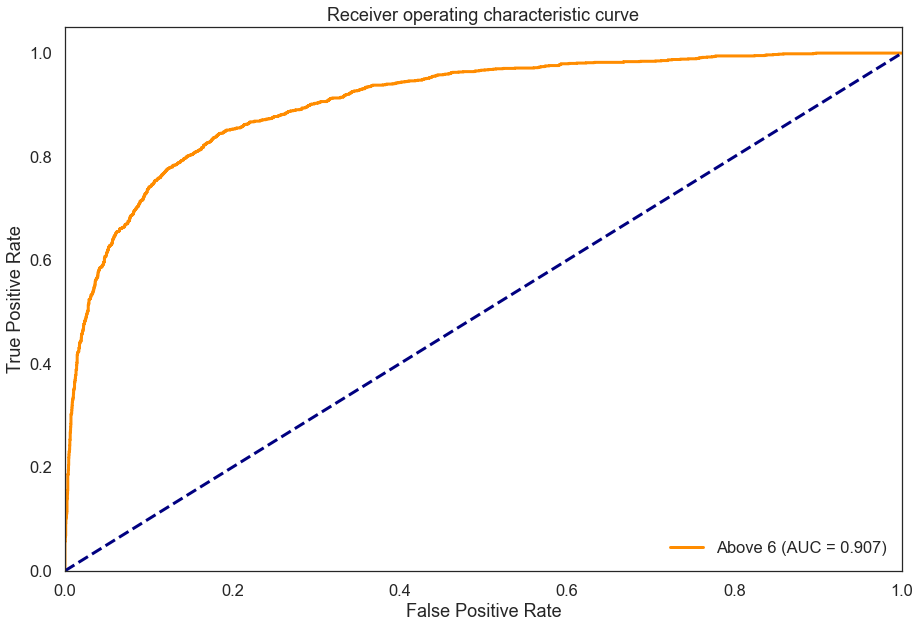

In [7]:
#ROC
plt.figure(figsize = (15,10))
lw = 3
fpr_rf_boot, tpr_rf_boot, thresholds_rf_boot = roc_curve(ml_y_test, rf_boot.predict_proba(ml_x_test)[:,1], pos_label=1)
rf_boot_AUC_test = roc_auc_score(ml_y_test, rf_boot.predict_proba(ml_x_test)[:,1])
plt.plot(fpr_rf_boot,tpr_rf_boot, color='darkorange',
         lw=lw, label='Above 6 (AUC = %0.3f)' % rf_boot_AUC_test)


plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic curve')
plt.legend(loc="lower right")


Text(0, 0.5, 'Precision')

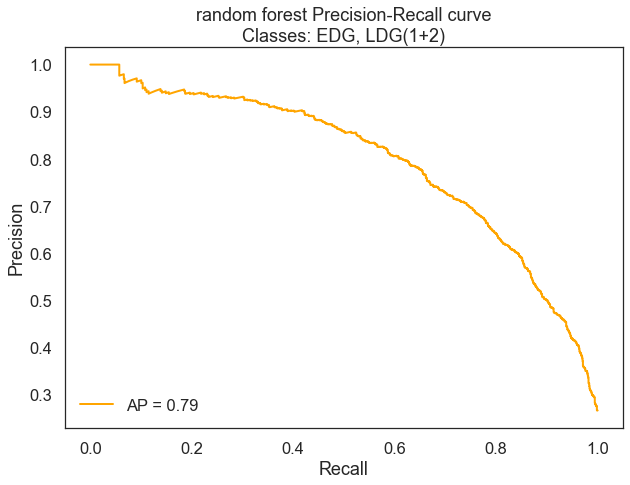

In [8]:
#plotting precision reall curve
average_precision_rf_boot = average_precision_score(ml_y_test, rf_boot.predict_proba(ml_x_test)[:,1])
precision, recall, _ = precision_recall_curve(ml_y_test, rf_boot.predict_proba(ml_x_test)[:,1])
plt.figure(figsize = (10, 7))
plt.plot(recall, precision, lw= 2, label='AP = %0.2f' % average_precision_rf_boot, color = 'orange')
plt.title('random forest Precision-Recall curve\nClasses: EDG, LDG(1+2)')
plt.legend(loc="lower left")
plt.xlabel('Recall')
plt.ylabel('Precision')


# SHAP analysis

In [9]:
# #shap plots of testset
# explainer_rf_boot = shap.TreeExplainer(rf_boot)
# shap_values_rf_boot = explainer_rf_boot.shap_values(ml_x_test)
# with open('shap_u.p', 'wb') as file:
#     pickle.dump([explainer_rf_boot,shap_values_rf_boot], file)

In [10]:
with open('shap_u.p', 'rb') as file:
        explainer_rf_boot, shap_values_rf_boot = pickle.load(file)

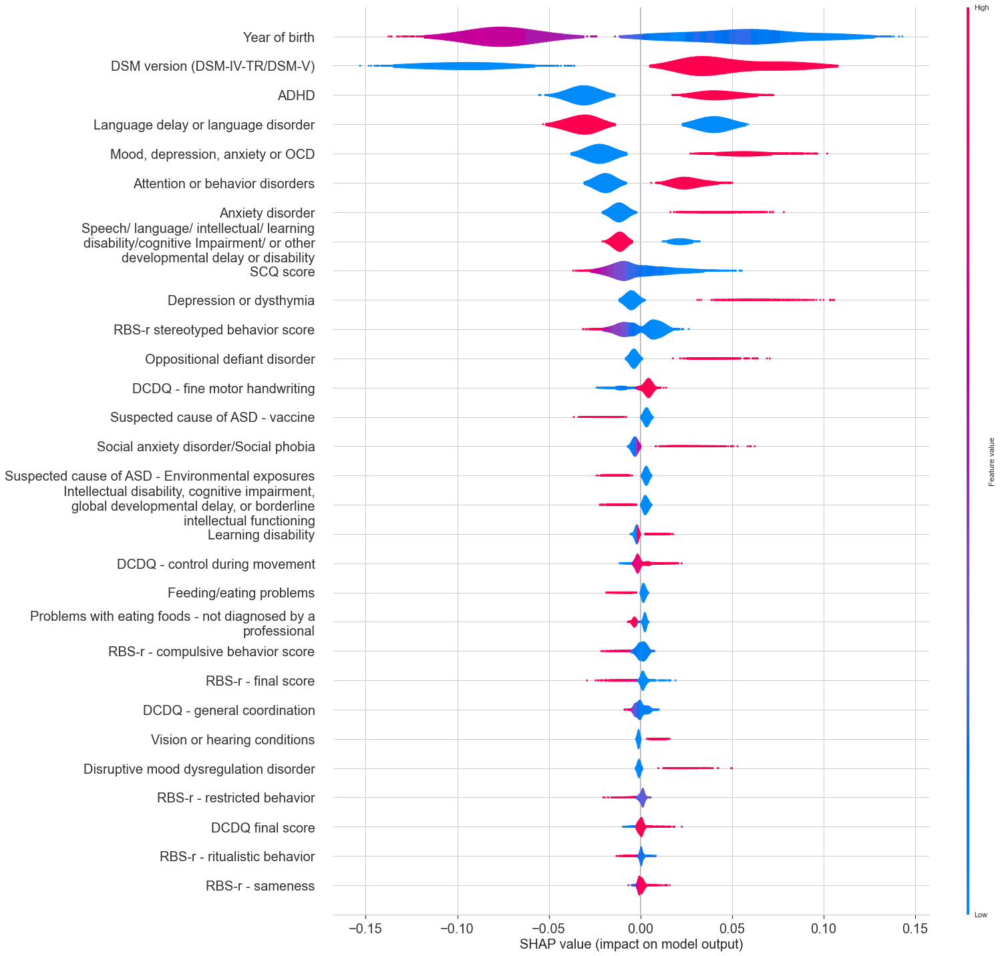

In [11]:
names_dict = {'YOB': 'Year of birth',
              'DSM' :'DSM version (DSM-IV-TR/DSM-V)',
              'dev_lang_dis':'Language delay or language disorder',
              'behav_adhd':'ADHD',
              'ADHD or ADD':'ADHD',
              'mood_or_anx':'Mood, depression, anxiety or OCD',
              'attn_behav':'Attention or behavior disorders',
              'dev_lang':'Speech/ language/ intellectual/ learning disability/cognitive Impairment/ or other developmental delay or disability',
              'mood_anx': 'Anxiety disorder',
              'final_score_scq': 'SCQ score',
              'mood_dep':"Depression or dysthymia",
              'fine_motor_handwriting':'DCDQ - fine motor handwriting',
              'susp_cause_enviro':'Suspected cause of ASD - Environmental exposures',
              'i_stereotyped_behavior_score': 'RBS-r stereotyped behavior score',
              'mood_soc_anx':'Social anxiety disorder/Social phobia',
              'Social Anxiety Disorder/Social Phobia':'Social anxiety disorder/Social phobia',
              'susp_cause_vaccine': 'Suspected cause of ASD - vaccine',
              'behav_odd':'Oppositional defiant disorder',
              'Oppositional Defiant Disorder': 'Oppositional defiant disorder',
              'control_during_movement':'DCDQ - control during movement',
              'dev_id':'Intellectual disability, cognitive impairment, global developmental delay, or borderline intellectual functioning',
              'feeding_dx':'Feeding/eating problems',
              'dev_ld':'Learning disability',
              'v_sameness_behavior_score':'RBS-r - sameness',
              'eating_probs':'Problems with eating foods - not diagnosed by a professional',
              'general_coordination':'DCDQ - general coordination',
              'final_score_dcdq': 'DCDQ final score',
              'med_cond_visaud':'Vision or hearing conditions',
              'iii_compulsive_behavior_score':'RBS-r - compulsive behavior score',
              'father_highest_education': "Father's highest education",
              'total_final_score_rebs-r':'RBS-r - final score',
              'mood_ocd':'OCD',
              'Obsessive-Compulsive Disorder':'OCD',
              'ii_self_injurious_score':'RBS-R - self injurious behavior',
              'sleep_probs':'Sleep problems not diagnosed by a professional',
              'dev_motor':'Motor delay',
              'med_cond_birth':'Birth or pregnancy complications',
              'mother_highest_education':"Mother's highest education",
              'iv_ritualistic_behavior_score': 'RBS-r - ritualistic behavior',
              'vi_restricted_behavior_score': "RBS-r - restricted behavior",
              'mood_dmd':'Disruptive mood dysregulation disorder',
              'Disruptive Mood Dysregulation Disorder':'Disruptive mood dysregulation disorder',
             'susp_cause_preg': 'Suspected cause of ASD - Problems during pregnancy',
             'susp_cause_pg_drug_etoh': 'Suspected cause of ASD - Drug or alcohol exposure in pregnancy',
             'susp_cause_birth': 'Suspected cause of ASD - Birth or delivery complication',
             'Suspected cause of ASD - Suspected cause of ASD':'Suspected cause of ASD - Birth or delivery complication',
             'nuclear_family_asd': 'Nuclear family ASD',
             'extended_family_asd': 'Extended family ASD',
             'zygosity_dz': 'Dizygotic twin',
             'twin_mult_birth_no': 'No twin',
             'twin_mult_birth_twin': 'Twin',
             'behav_conduct': 'Conduct disorder',
             'behav_intermitt_explos': 'Intermittent explosive disorder',
             'mood_hoard': 'Hoarding',
             'mood_sep_anx': 'Separation anxiety',
             'schiz': 'Schizophrenia,other psychosis or schizoaffective disorder',
             'cognitive_impairment': 'Cognitive impairment',
             'dev_soc_prag': 'Social communication disorder',
             'dev_speech': 'Speech articulation problems',
             'sleep_dx': 'Sleep disorder diagnosed by a professional',
             'tics': 'Tourette syndrome or tic disorder',
             'neuro_sz': 'Seizure disorder or epilepsy',
             'med_cond_neuro': 'Neurological conditions',
             'birth_prem': 'Premature birth (delivery before 37 weeks)',
             'birth_oxygen': 'Insufficient oxygen at birth with NICU stay',
             'cog_med': 'Cognitive delays or impairment due to a medical condition or exposure',
             'neuro_tbi': 'Traumatic brain injury',
             'med_cond_growth': 'Growth conditions',
             'growth_low_wt': 'Difficulty gaining weight',
             'growth_macroceph': 'Macrocephaly',
             'growth_obes': 'Obesity',
             'growth_short': 'Short stature',
             'visaud_strab': 'Strabismus',
             'susp_cause_medical':"Suspected cause of ASD - Medical conditions",
             'sex':'Sex',
             'mood_bipol':'Bipolar disorder',
             'med_cond_birth':'Birth or pregnancy complications',
             "annual_household_income":"Annual household income",
              'birth_def_thorac': 'Heart or lung birth defect',
              'birth_etoh_subst':"Fetal Alcohol Syndrome, alcohol or drug exposure in mother's pregnancy",
             "birth_def_bone":"Birth defects of bones, hands or feet" ,
            "birth_def_bone_miss":"Missing or malformed bones",
            "birth_def_cns":"Brain and spinal cord birth defects",
            "birth_def_cns_brain":"Brain malformation/abnormality (shown on MRI)",
            "birth_def_fac":"Facial birth defect",
            "birth_def_gastro":"Gastrointestinal birth defects",
             "birth_def_thorac_heart":"Congenital heart disease/defect",
            "birth_def_urogen":"Urinary or genital birth defect",
            "birth_ivh":"Intraventricular hemorrhage at birth",
            "med_cond_birth_def":"Birth defects",
            "neuro_inf":"Brain infection",
            "neuro_lead": "Lead poisoning",
            "twin_partic":"Twin participating in SPARK",
            "susp_cause_other":"Suspected cause of ASD - Other",
            "overall_family_asd":"Overall Family ASD",
              "visaud_deaf":"Deafness/hearing loss",
              "dev_mutism":"Mutism",
              "visaud_blind":"Blindness",
              "growth_microceph":"Microcephaly",
              "birth_def_bone_polydact":"Extra fingers and/or extra toes",
            "birth_def_bone_spine":"Spine deformity",
            "birth_def_cleft_lip":"Cleft lip",
            "birth_def_cleft_palate":"Cleft palate",
            "birth_def_cns_myelo":"Spina bifida/myelomeningocele",
            "birth_def_gi_esoph_atres":"Esophageal atresia",
            "birth_def_gi_hirschprung":"Hirschsprung disease",
            "birth_def_gi_intest_malrot":"Intestinal malrotation",
            "birth_def_gi_pylor_sten":"Pyloric stenosis",
            "birth_def_thorac_cdh":"Congenital diaphragmatic hernia",
            "birth_def_thorac_lung":"Lung malformation",
            "birth_def_urogen_hypospad":"Hypospadias",
            "birth_def_urogen_renal":"Kidney malformation",
            "birth_def_urogen_renal_agen":"Missing kidney",
            "birth_def_urogen_uter_agen":"Missing uterus",
            "birth_pg_inf":"Serious prenatal infection",
            "etoh_subst":"Alcohol or Substance Use",
            "gest_age":"Gestational age",
            "pers_dis":"Personality Disorder",
            "visaud_catar":"Cataract",
            "susp_cause_genetic":"Suspected cause of ASD - Genetic causes",
            "susp_cause_infection":"Suspected cause of ASD - Infection in infancy or early childhood",
            "susp_cause_dk":"Suspected cause of ASD - Don't know",
            "zygosity_mz":"Monozygotic twin",
            "zygosity_not_sure":"Zygosity - Not sure",
            "twin_mult_birth_triplet_other":"Part of triplet, quadruplet or other",
            "birth_def_bone_club":"Clubbed foot"	

}
names = ml_x_test.rename(columns = names_dict).columns
sns.set(style = 'whitegrid', font_scale = 10)
shap.summary_plot(shap_values_rf_boot[1], ml_x_test, plot_type = 'violin', max_display = 30, feature_names = names, plot_size  = (20,25), show = False)
sns.set(style= 'whitegrid')
f = lambda x: textwrap.fill(x.get_text(), 50)
ax = plt.gca()
ax.set_yticks(ax.get_yticks())
ax.set_yticklabels(map(f, ax.get_yticklabels()))
for tick in ax.yaxis.get_major_ticks():
            tick.label.set_fontsize(20)
for tick in ax.xaxis.get_major_ticks():
            tick.label.set_fontsize(20)
ax.xaxis.label.set_size(20)


# Clustsering late diagnosed probands

In [12]:
data = ml_all_spark[ml_all_spark.age_group == 1].rename(columns = names_dict)
sclr = StandardScaler()
data_minmax = pd.DataFrame(sclr.fit_transform(data.replace(-1,np.nan)), columns=data.columns).fillna(0)



In [13]:
clus_num = 2
#clus = AgglomerativeClustering(n_clusters = clus_num, affinity='euclidean', linkage = 'complete')
clus = KMeans(n_clusters = clus_num, algorithm='elkan', max_iter=1000, random_state = 45)
clusters = clus.fit_predict(data_minmax)
data['clusters'] = clusters + 1


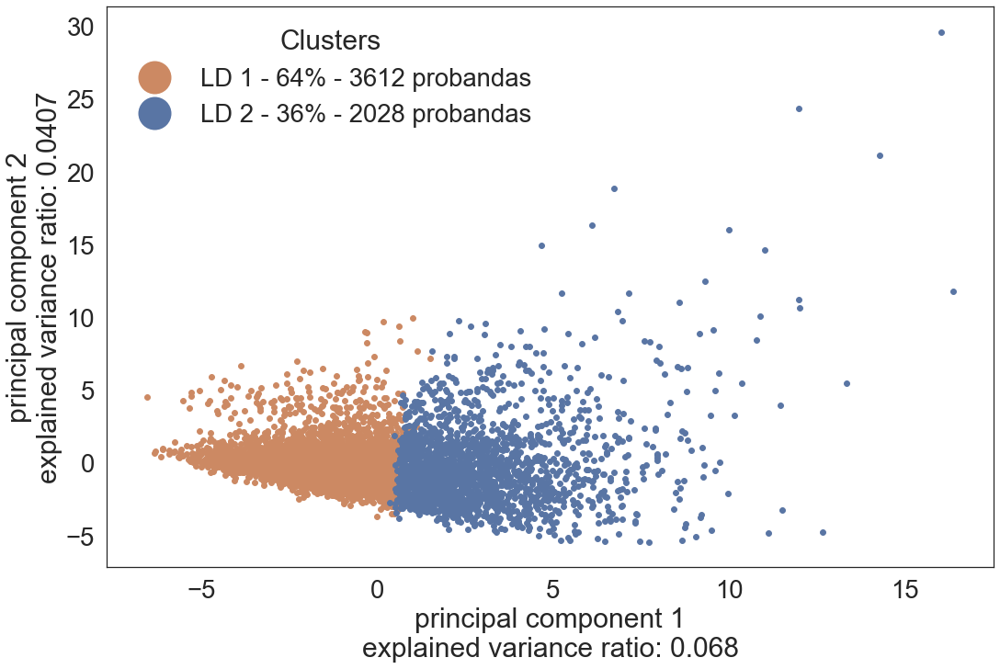

In [14]:
px = data_minmax
pca = PCA(n_components=3)
pca_vals = pca.fit_transform(px)
principalDf = pd.DataFrame(data = pca_vals
     , columns = ['principal component 1', 'principal component 2','principal component 3'])
principalDf['cluster'] = clusters

colors = ['#CC8963','#5975A4','#F57C00', '#FFDA70', '#3C8C3F','#3F3934','#7B83EB']
labels = [1,2]
legend_lables = ['LD {} - {:.0%} - {} probandas'.format(i, sum(data.clusters == i)/len(data), sum(data.clusters == i)) for i in range(1, 1+clus_num)]
sns.set(font_scale = 2.5,style = 'white')
fig, ax = plt.subplots(figsize = (15,10), constrained_layout = True)

for cluster, color in zip(range(clus_num), colors[:clus_num]):
    x = principalDf.loc[principalDf.cluster == cluster, 'principal component 1']
    y = principalDf.loc[principalDf.cluster == cluster, 'principal component 2']    
    ax.scatter(x, y, s = 35, c=color)
handles = [plt.Line2D([],[],marker="o", ls="", 
                      color=colors[yi]) for yi in range(clus_num)]

plt.legend(handles, legend_lables, title = 'Clusters', fancybox=False, markerscale  = 6)

ax.set_xlabel('principal component 1\nexplained variance ratio: {:.3}'\
              .format(pca.explained_variance_ratio_[0]))
ax.set_ylabel('principal component 2\nexplained variance ratio: {:.3}'\
              .format(pca.explained_variance_ratio_[1]))
plt.show()

In [15]:
category_cols = ["Sex",
"Attention or behavior disorders",
"age_group",
"Suspected cause of ASD - Genetic causes",
"Suspected cause of ASD - Medical conditions",
"Suspected cause of ASD - Environmental exposures",
"Suspected cause of ASD - Problems during pregnancy",
"Suspected cause of ASD - Drug or alcohol exposure in pregnancy",
"Suspected cause of ASD - Birth or delivery complication",
"Suspected cause of ASD - Infection in infancy or early childhood",
"Suspected cause of ASD - vaccine",
"Suspected cause of ASD - Other",
"Twin participating in SPARK",
"Suspected cause of ASD - Don't know",
"Overall Family ASD",
"Nuclear family ASD",
"Extended family ASD",
"Dizygotic twin",
"Monozygotic twin",
"Zygosity - Not sure",
"No twin",
"Part of triplet, quadruplet or other",
"Twin",
"Mood, depression, anxiety or OCD",
"Neurological conditions",
"Birth or pregnancy complications",
"Birth defects",
"Growth conditions",
"Intellectual disability, cognitive impairment, global developmental delay, or borderline intellectual functioning",
"Speech/ language/ intellectual/ learning disability/cognitive Impairment/ or other developmental delay or disability",
"Heart or lung birth defect",
"Gastrointestinal birth defects",
"Facial birth defect",
"Brain and spinal cord birth defects",
"Birth defects of bones, hands or feet"]

data_binary = data.copy()
for col in data.columns:
    if len(set(data[col].unique()).difference(set([0,1,-1]))) > 0:
        data_binary.drop(col, axis = 1, inplace = True)
data_binary.drop(category_cols, axis = 1, inplace = True)
data_binary['clusters'] = data['clusters']

data0 = ml_all_spark[ml_all_spark.age_group == 0].rename(columns = names_dict).copy()
for col in data.drop('clusters', axis = 1).columns:
    if len(set(data0[col].unique()).difference(set([0,1,-1]))) > 0:
        data0.drop(col, axis = 1, inplace = True)
data0.drop(category_cols, axis = 1, inplace = True)


In [16]:
data_binary1 = data_binary[data_binary.clusters == 1].drop('clusters', axis = 1)
data_binary2 = data_binary[data_binary.clusters == 2].drop('clusters', axis = 1)
data_All = [data0, data_binary1, data_binary2] 
groups = ['EDG', 'LD1', 'LD2']
for g,df in zip(groups,data_All):
    print(f"Avg. amount of problems for {g} = {sum(df.sum(axis = 1))/len(df):.2f}")

LD1EDG = ttest_ind(data0.sum(axis = 1), data_binary1.sum(axis = 1), alternative='greater')
LD2EDG = ttest_ind(data_binary2.sum(axis = 1), data0.sum(axis = 1), alternative='greater')
comp = [LD1EDG,LD2EDG]
text = ['EDG>LD1', 'LD2>EDG']
for t,c in zip(text,comp):
    print(f"In the t-test comparison of the hypothesis that {t}: (t = {c[0]:.2f}, p = {c[1]:.2e})")



Avg. amount of problems for EDG = 4.34
Avg. amount of problems for LD1 = 3.47
Avg. amount of problems for LD2 = 8.12
In the t-test comparison of the hypothesis that EDG>LD1: (t = 15.21, p = 3.01e-52)
In the t-test comparison of the hypothesis that LD2>EDG: (t = 48.26, p = 0.00e+00)


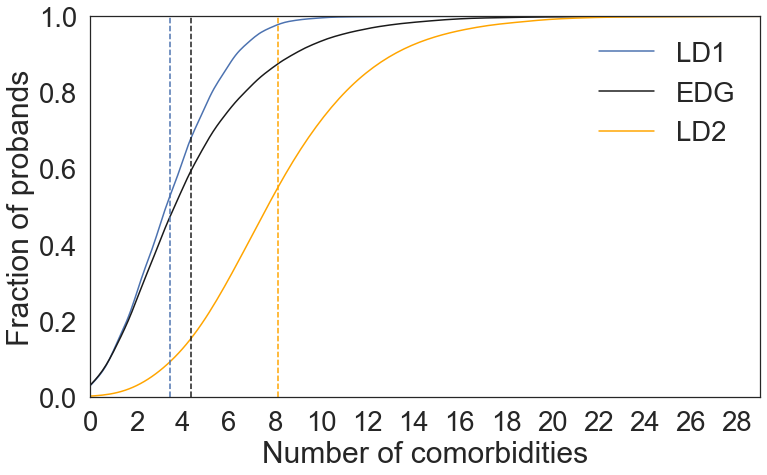

In [18]:
disorder_counts_1 = data_binary1.sum(axis = 1)
disorder_counts_2 = data_binary2.sum(axis = 1)
disorder_counts_0 = data0.sum(axis = 1)
fig, ax = plt.subplots()
kwargs = {'cumulative': True}
sns.distplot(disorder_counts_1, kde_kws=kwargs, hist = False, color = 'b', label = 'LD1', ax = ax)
sns.distplot(disorder_counts_0, kde_kws=kwargs, hist = False, color = 'k', label = 'EDG', ax = ax)
sns.distplot(disorder_counts_2, kde_kws=kwargs, hist = False, color = 'orange', label = 'LD2', ax = ax)
# sns.ecdfplot(disorder_counts_1,color = 'b', label = 'LD1', ax = ax)
# sns.ecdfplot(disorder_counts_0, color = 'k', label = 'EDG', ax = ax)
# sns.ecdfplot(disorder_counts_2,  color = 'orange', label = 'LD2',ax = ax)
plt.xticks(np.arange(min(disorder_counts_1), max(disorder_counts_2)+1, 2))
plt.xlabel('Number of comorbidities')
plt.ylabel('Fraction of probands')
plt.axvline(x=3.47, color = 'b',  linestyle = '--')
plt.axvline(x=4.34, color = 'k', linestyle = '--')
plt.axvline(x=8.12, color = 'orange', linestyle = '--')
plt.rcParams['figure.figsize'] =12,7
plt.ylim(0,1)
plt.xlim(min(disorder_counts_1), max(disorder_counts_2)+1)
plt.legend()

In [21]:
def odds(clusters = 3, data = None, data_y = None, n_iter = 1000):
    from tqdm import tqdm
    #creating dataframes to save values
    stat_pvals = pd.DataFrame([], columns = data.drop('clusters', axis = 1).columns, index = ['cluster_{}'.format(i) for i in range(clusters)])
    stat =  pd.DataFrame([], columns = data.drop('clusters', axis = 1).columns, index = ['cluster_{}'.format(i) for i in range(clusters)])
    res_dict = {'cluster_{}'.format(k):{} for k in range(clusters)}
    for _ in tqdm(range(n_iter)):
            for i in range(clusters): 
                c_data = data[data.clusters == i].drop('clusters', axis = 1)
                data_a = pd.concat([c_data, data_y.sample(len(c_data), replace = True)])
                for col in data_a.drop(['age_group'], axis = 1).columns:              
                    if col not in res_dict['cluster_{}'.format(i)]:
                        res_dict['cluster_{}'.format(i)][col] = {}
                        res_dict['cluster_{}'.format(i)][col]['statistics'] = []
                        res_dict['cluster_{}'.format(i)][col]['pvals'] = []
                        res_dict['cluster_{}'.format(i)][col]['medians'] = []
                        res_dict['cluster_{}'.format(i)][col]['means'] = []
                        res_dict['cluster_{}'.format(i)][col]['ratio0'] = []
                        res_dict['cluster_{}'.format(i)][col]['ratio1'] = []

                    if len(data_a[col].dropna(axis = 0).unique()) <= 2:
                        ct = pd.crosstab(data_a[col], data_a['age_group'])
                        not_in = {0,1}.difference(set(ct.columns))
                        if len(not_in) > 0:
                            for j in not_in:
                                ct['{}'.format(j)] = 0
                        not_in_index = {0.0,1.0}.difference(set(ct.index))
                        if len(not_in_index) > 0 and not col.startswith('DSM'):
                            for t in not_in_index:
                                ct = ct.append(pd.DataFrame([[0,0]], columns = ct.columns, index = ['{}'.format(t)]))
                        elif col.startswith('DSM'):
                            not_in_index = {4.5,5.0}.difference(set(ct.index))
                            if len(not_in_index) > 0:
                                for t in not_in_index:
                                    ct = ct.append(pd.DataFrame([[0,0]], columns = ct.columns, index = ['{}'.format(t)]))
#                         print(i, col)
                        ct = ct+0.5 # Haldane-Anscombe correction FROM https://www.researchgate.net/post/How_to_calculate_OR_odd_ratio_if_one_of_groups_is_0_in_a_case-control_study
                        res_dict['cluster_{}'.format(i)][col]['ratio0'].append(ct.iloc[1,0]/ct.iloc[:,0].sum()) 
                        res_dict['cluster_{}'.format(i)][col]['ratio1'].append(ct.iloc[1,1]/ct.iloc[:,1].sum())
                        statistic, pvalue = fisher_exact(ct)
                        res_dict['cluster_{}'.format(i)][col]['statistics'].append(statistic)
                        res_dict['cluster_{}'.format(i)][col]['pvals'].append(pvalue)
                    else:
                        v0 = data_a.loc[data_a.age_group == 0, col]
                        v1 = data_a.loc[data_a.age_group == 1, col]
                        _, pvalue = mannwhitneyu(v0,v1)
                        statistic = np.mean(v1)/np.mean(v0)
                        res_dict['cluster_{}'.format(i)][col]['statistics'].append(statistic)
                        res_dict['cluster_{}'.format(i)][col]['pvals'].append(pvalue)
                        res_dict['cluster_{}'.format(i)][col]['medians'].append(np.median(v0))
                        res_dict['cluster_{}'.format(i)][col]['means'].append(np.mean(v0))

    for c in res_dict:
        for col in res_dict[c]:
            s = np.median(res_dict[c][col]['statistics'])
            p = np.median(res_dict[c][col]['pvals'])
            stat.loc[c, col] = s
            stat_pvals.loc[c, col] = p
    rel_cols = [col for col in stat_pvals.columns if any(stat_pvals[col] <= 0.05)]   
    return stat, stat_pvals, rel_cols, res_dict



In [22]:
# stat, stat_pvals, rel_cols, res_dict = odds(data = data, clusters = 2, data_y= ml_all_spark[ml_all_spark.age_group == 0].rename(columns=names_dict), n_iter = 1000)


In [23]:

# with open('rel_cols_u_CORRECTED.p', 'wb') as f:
#     pickle.dump([stat, stat_pvals, rel_cols, res_dict],f)


In [27]:
with open('rel_cols_u_CORRECTED.p', 'rb') as f:
    stat, stat_pvals, rel_cols, res_dict = pickle.load(f)
    stat.rename(columns = names_dict, inplace = True)
    stat_pvals.rename(columns = names_dict, inplace = True)
    rel_cols = [names_dict.get(i,i) for i in rel_cols]

In [28]:
def fdr_cor(df_p):
    p_array = df_p.values.reshape(1,-1)[0]
    mask = np.where(~pd.isna(p_array))
    rejected, corrected = fdrcorrection(p_array[mask])
    p_array[mask] = corrected
    df_p = pd.DataFrame(p_array.reshape(df_p.shape), columns = df_p.columns, index = df_p.index)
    return df_p

def fdr_nan(df_p, df_s, sig = 0.05, nulls = True, drop = True):
    pd.options.mode.chained_assignment = None  # default='warn'
    df_p = fdr_cor(df_p)
    for i,row in df_p.iterrows():
        if nulls:
            non_sig = (row > sig).tolist()
            df_s.loc[i,non_sig] = np.nan
            df_p.loc[i,non_sig] = np.nan
    if drop:
        df_p.dropna(how = 'all', axis = 1, inplace = True)
        df_s.dropna(how = 'all', axis = 1, inplace = True)
    #df_s = df_s.astype(float).apply(np.log)
    pd.options.mode.chained_assignment = 'warn'
    return df_p, df_s
test_p, test_s = fdr_nan(stat_pvals[rel_cols], stat[rel_cols])
test_p.index = test_s.index = ['LD 1', 'LD 2']

In [29]:
def medianCI(data, ci, p):
	'''
	data: pandas datafame/series or numpy array
	ci: confidence level
	p: percentile' percent, for median it is 0.5
	output: a list with two elements, [lowerBound, upperBound]
	'''
	if type(data) is pd.Series or type(data) is pd.DataFrame:
		#transfer data into np.array
		data = data.values

	data = np.sort(data)
	N = data.shape[0]
	
	lowCount, upCount = st.binom.interval(ci, N, p, loc=0)
	#given this: https://perfeval.epfl.ch/printMe/perf.pdf, https://online.stat.psu.edu/stat415/lesson/19/19.1 
	#lowCount and upCount both refers to  W's value, W follows binomial Dis.
	#lowCount need to change to lowCount-1, upCount no need to change in python indexing
	lowCount -= 1
	# print lowCount, upCount
	return data[int(lowCount)], data[int(upCount)]

In [30]:
cs = ['Cluster 0', 'Cluster 1']
cols = ['statistic', 'statistic_type', 'p_value','low_CI', 'high_CI']
all_cols = []
for c in cs :
    for col in cols:
        all_cols.append([c,col])

inddf = pd.DataFrame(all_cols)
index = pd.MultiIndex.from_frame(inddf)
dfs = []
p_vals_df, stat = fdr_nan(stat_pvals[rel_cols], stat[rel_cols], nulls = False)
for c in range(len(res_dict)):
    cluster_df = pd.DataFrame()
    for k in res_dict['cluster_{}'.format(c)]:
        t = res_dict['cluster_{}'.format(c)][k]
        vec = []
        vec.append(np.median(t['statistics']))
        if len(t['means']) > 0:
            vec.append('means reatio')
        else:
            vec.append('odds reatio')
        vec.append(np.median(t['pvals']))
        ci = medianCI(t['statistics'], 0.95, 0.5)
        vec.append(ci[0])
        vec.append(ci[1])
        if k in names_dict.keys():
            name = k.replace(k,names_dict[k])
        else:
            name = k
        cluster_df = cluster_df.append(pd.Series(vec, name = name))
    dfs.append(cluster_df)

all_stats = pd.concat(dfs, axis = 1)
all_stats.columns = index
# all_stats.to_excel('full_stats.xlsx')
        
        
            

In [31]:
a = ['Sex',
'DSM version (DSM-IV-TR/DSM-V)',
'Twin',
'Overall Family ASD',
]


b = ['Language delay or language disorder',
  'Speech/ language/ intellectual/ learning disability/cognitive Impairment/ or other developmental delay or disability',
'Speech articulation problems',
     'Cognitive impairment',
    'Cognitive delays or impairment due to a medical condition or exposure',
'Intellectual disability, cognitive impairment, global developmental delay, or borderline intellectual functioning',
'Learning disability',
'Social communication disorder',
'Motor delay',]


c = ['ADHD',
     'Anxiety disorder',
'Separation anxiety',
'Social anxiety disorder/Social phobia',
'Hoarding',
'OCD',
'Bipolar disorder',
'Depression or dysthymia',
'Disruptive mood dysregulation disorder',
'Conduct disorder',
'Intermittent explosive disorder',
'Oppositional defiant disorder',
'Schizophrenia,other psychosis or schizoaffective disorder',
'Tourette syndrome or tic disorder',]

d = ['Birth defects',
    'Birth defects of bones, hands or feet',
'Missing or malformed bones',
'Brain and spinal cord birth defects',
'Brain malformation/abnormality (shown on MRI)',
'Facial birth defect',
'Gastrointestinal birth defects',
'Heart or lung birth defect',
'Congenital heart disease/defect',
'Urinary or genital birth defect',
]

e = ['Birth or pregnancy complications',
    "Fetal Alcohol Syndrome, alcohol or drug exposure in mother's pregnancy",
'Insufficient oxygen at birth with NICU stay',
'Premature birth (delivery before 37 weeks)',
     'Intraventricular hemorrhage at birth',
]

f = ['Problems with eating foods - not diagnosed by a professional',
'Feeding/eating problems',
'Sleep disorder diagnosed by a professional',
'Sleep problems not diagnosed by a professional',]

g = ['Growth conditions',
'Obesity',
'Difficulty gaining weight',
'Macrocephaly',
'Microcephaly',
'Short stature',]

h = ['Neurological conditions',
'Vision or hearing conditions',
'Blindness',
'Deafness/hearing loss',
'Strabismus',
'Brain infection',
'Seizure disorder or epilepsy',
'Traumatic brain injury',]

col_cat = [a,b,c,d,e,f, g, h]
all_cat = [i for cols in col_cat for i in cols]

In [32]:
i =  ["Mother's highest education",
"Father's highest education",
#'Year of birth'
]

j = ['DCDQ - control during movement',
'DCDQ final score',
'DCDQ - fine motor handwriting',
'DCDQ - general coordination',]

k = ['RBS-r stereotyped behavior score',
'RBS-R - self injurious behavior',
'RBS-r - compulsive behavior score',
'RBS-r - ritualistic behavior',
'RBS-r - sameness',
'RBS-r - restricted behavior',
'RBS-r - final score',
'SCQ score',]

col_scale = [i, k, j]
all_scale = [i for cols in col_scale for i in cols]

In [33]:
def scale_log_pval(p):
    #mylist = np.linspace(1,120, 10)
    if pd.isna(p) == True:
        return 0
    else:
        p = -1*np.log10(p)
        #for_ind = min(mylist, key=lambda x:abs(x-p))
        return np.sqrt(p)#np.where(mylist == for_ind)[0][0] + 1

def heatmap_circle(input_colors, input_sizes, 
                   row_cluster=False, col_cluster=False, 
                   cluster_on="color", method="ward", vmin=None, vmax=None,
                   cmap="RdBu_r", max_size = None, colorbar_label = 'log odds ratio', annot = False): #color = DEG, size = significance p-value
    
    sns.set(font_scale = 1.5, style = 'white')
    
    if input_colors.shape != input_sizes.shape:
        raise InputError("Input matrices must be the same shape.")
    if all(input_colors.index == input_sizes.index) == False:
        raise InputError("Input indexes and order must be equal.")
    if all(input_colors.columns == input_sizes.columns) == False:
        raise InputError("Input columns and order must be equal.")
    
    input_sizes = input_sizes.applymap(scale_log_pval)
    
    if cluster_on=="color":
        clustergrid = sns.clustermap(input_colors,cmap="RdBu_r",
                                    row_cluster=row_cluster,col_cluster=col_cluster, method=method)
        row_order = clustergrid.dendrogram_row.reordered_ind if row_cluster else range(len(input_colors.index))
        col_order = clustergrid.dendrogram_col.reordered_ind if col_cluster else range(len(input_colors.columns))
        input_colors = input_colors.iloc[row_order,col_order]
        input_sizes = input_sizes.iloc[row_order,col_order]
        plt.clf()
    elif cluster_on=="size":
        clustergrid = sns.clustermap(input_sizes,cmap="RdBu_r",
                                    row_cluster=row_cluster,col_cluster=col_cluster, method=method)
        row_order = clustergrid.dendrogram_row.reordered_ind if row_cluster else range(len(input_colors.index))
        col_order = clustergrid.dendrogram_col.reordered_ind if col_cluster else range(len(input_colors.columns))
        input_colors = input_colors.iloc[row_order,col_order]
        input_sizes = input_sizes.iloc[row_order,col_order]
        plt.clf()
        
    fig, ax = plt.subplots(figsize = (len(input_colors) *2, len(input_colors)), dpi = 150)

    N,M = input_colors.shape
    ylabels = list(input_colors.index)
    xlabels = list(input_colors.columns)
    
    x, y = np.meshgrid(np.arange(M), np.arange(N))
    s = input_sizes.values #size column
    c = input_colors.values

    R = s/(2*max_size)
    circles = [plt.Circle((j,i), radius=r) for r, j, i in zip(R.flat, x.flat, y.flat)]
    col = PatchCollection(circles, array=c.flatten(), cmap=cmap,norm=mpl.colors.Normalize(vmin=vmin,vmax=vmax),
                          edgecolor = 'black')
    ax.add_collection(col)
    if annot:
        for S, j, i in zip(c.flat, x.flat, y.flat):
            if S != 0:
                ax.annotate('{:.2f}'.format(S), xy=(j-0.25, i+0.25), ha = 'center', weight = 'bold', fontsize = 16)
    ax.set(xticks=np.arange(M), yticks=np.arange(N),
           xticklabels=xlabels, yticklabels = ylabels)
    f = lambda x: textwrap.fill(x.get_text(), 70)
    ax.set_yticklabels(map(f, ax.get_yticklabels()))
    ax.set_xticks(np.arange(M+1)-0.5, minor=True)
    ax.set_yticks(np.arange(N+1)-0.5, minor=True)
    ax.yaxis.tick_right()
    ax.grid(which= 'minor')
    ax.set_facecolor((1,1,1,0))
    #plt.grid(b=None)
    
    plt.gca().set_aspect('equal', adjustable='box')
    plt.setp(ax.get_xticklabels(), rotation=90,ha="right")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("left", size=0.25, pad=0.3)
    plt.colorbar(col, ax=[ax],label = colorbar_label, cax=cax)
    cax.yaxis.set_ticks_position('left')
    cax.yaxis.set_label_position('left')

    #plt.colorbar(col, , ax=[ax],label = colorbar_label) 

<Figure size 720x720 with 0 Axes>

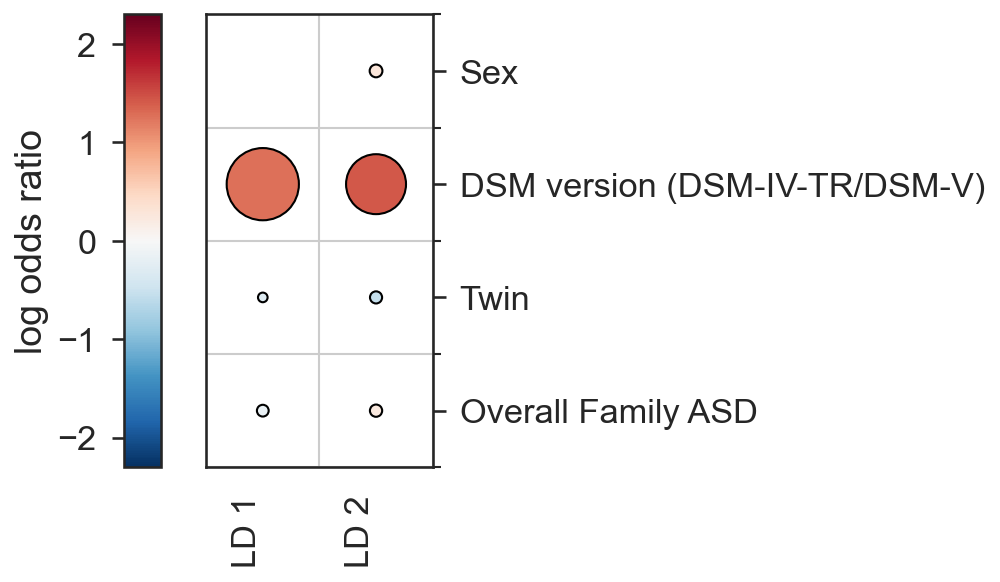

<Figure size 720x720 with 0 Axes>

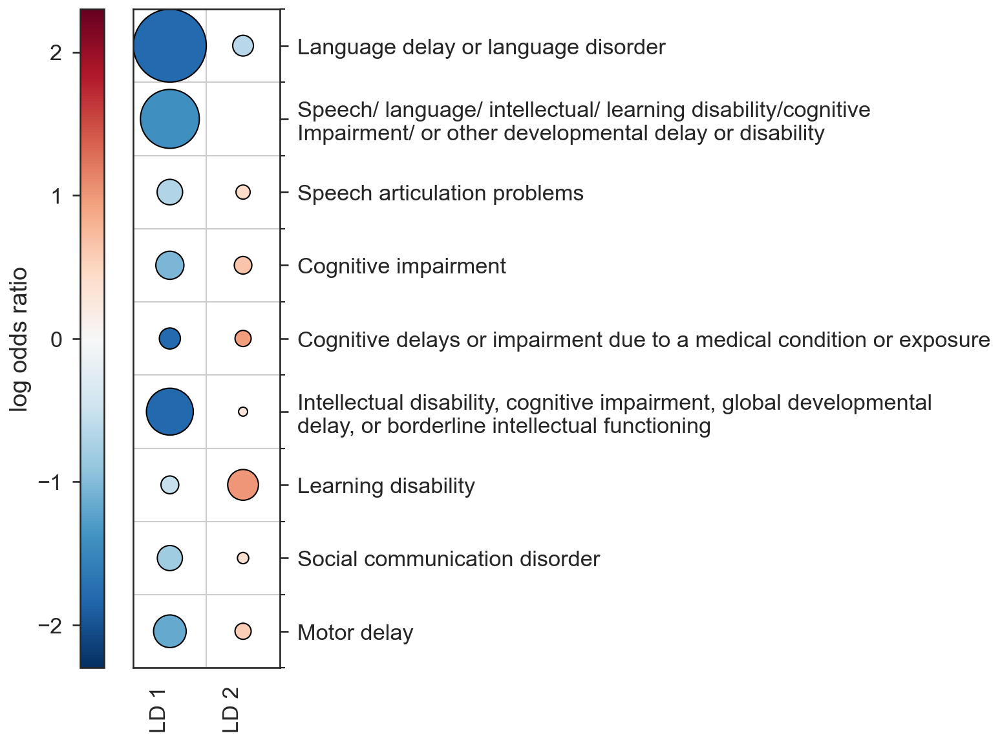

<Figure size 720x720 with 0 Axes>

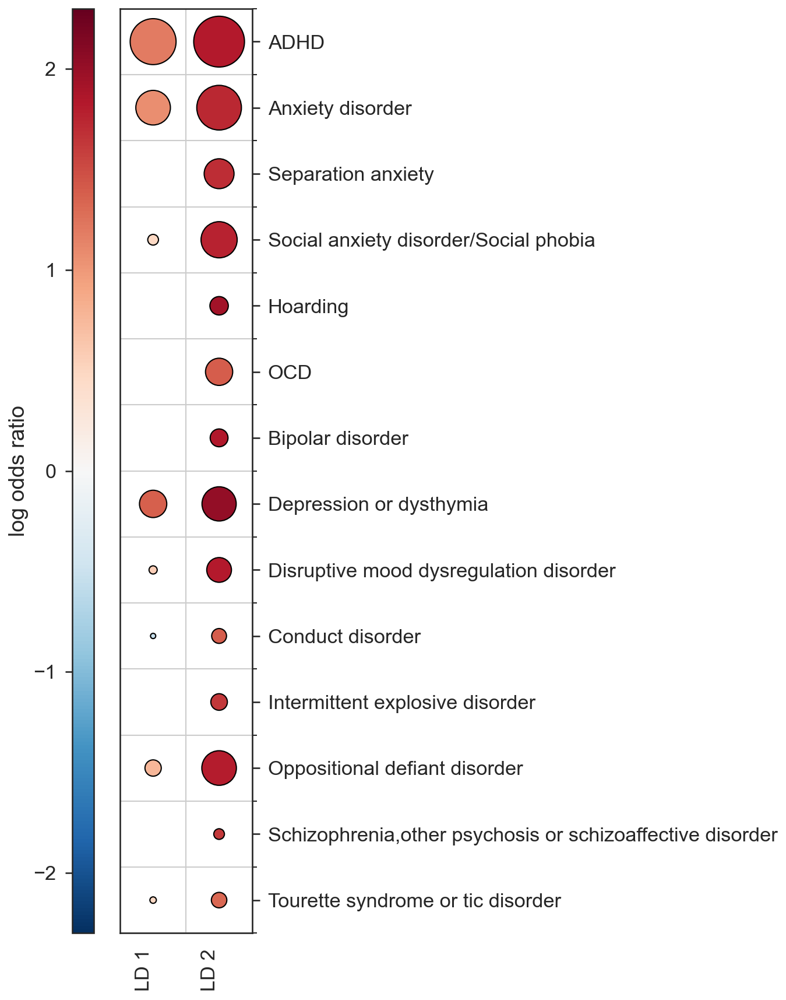

<Figure size 720x720 with 0 Axes>

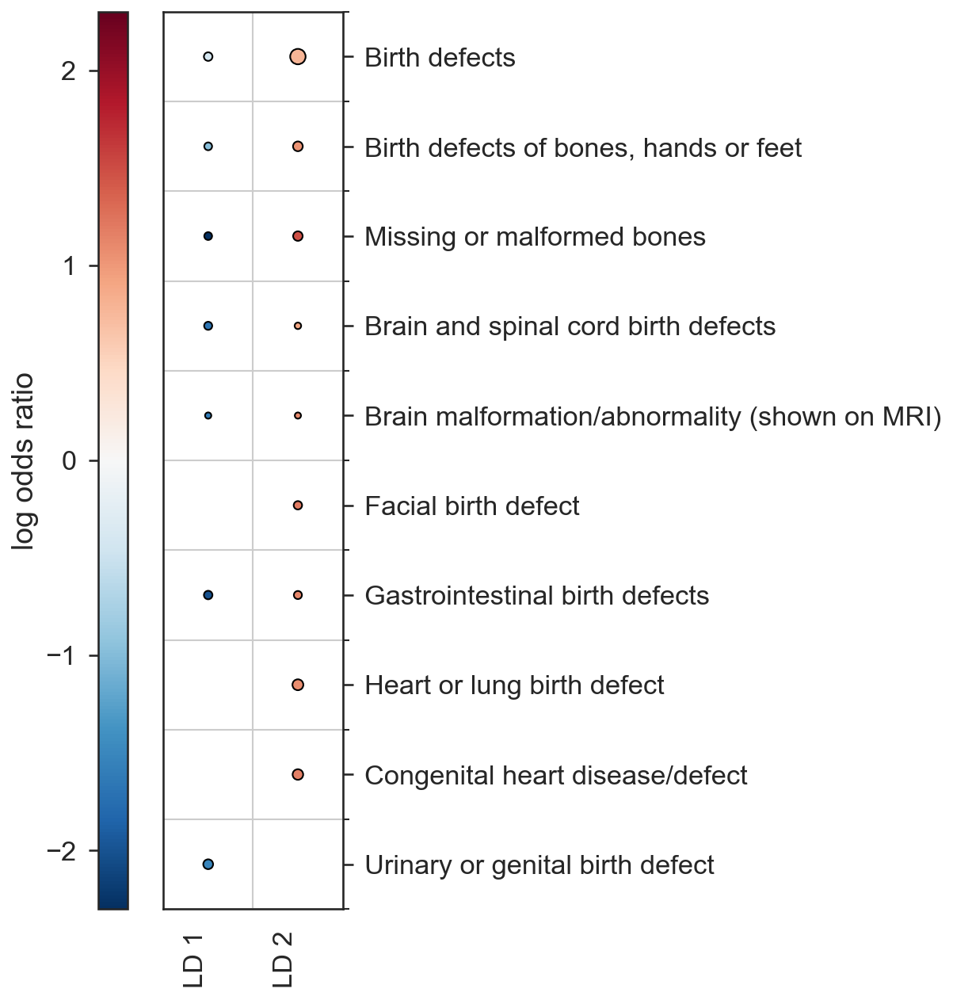

<Figure size 720x720 with 0 Axes>

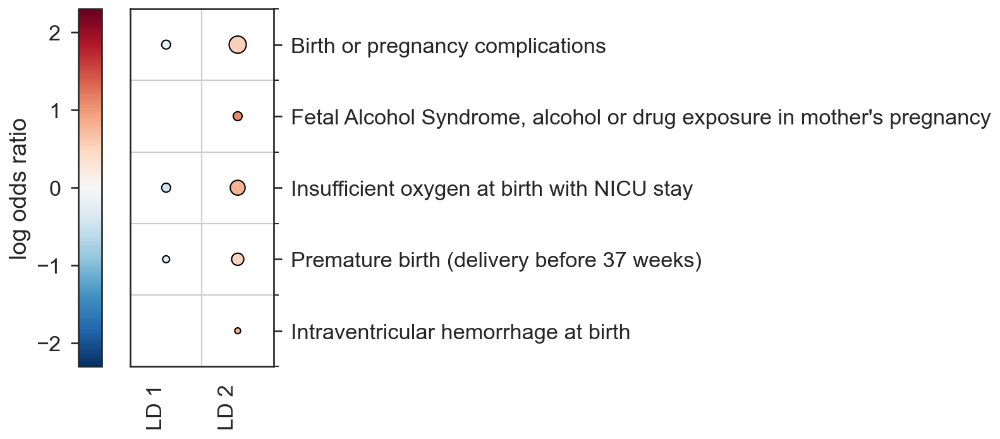

<Figure size 720x720 with 0 Axes>

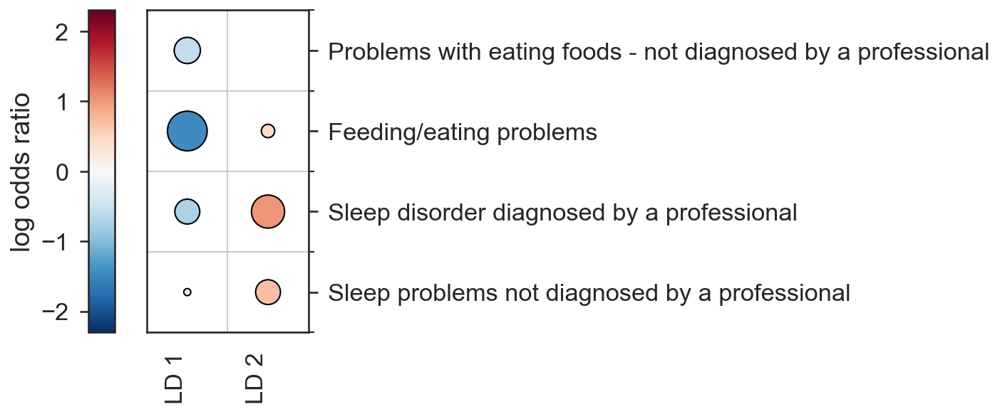

<Figure size 720x720 with 0 Axes>

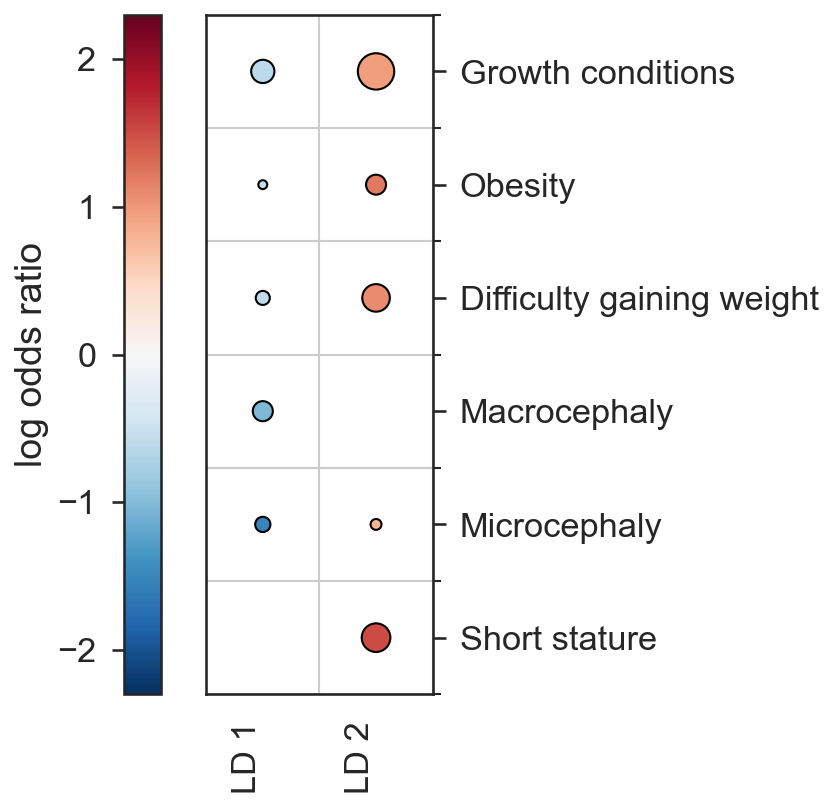

<Figure size 720x720 with 0 Axes>

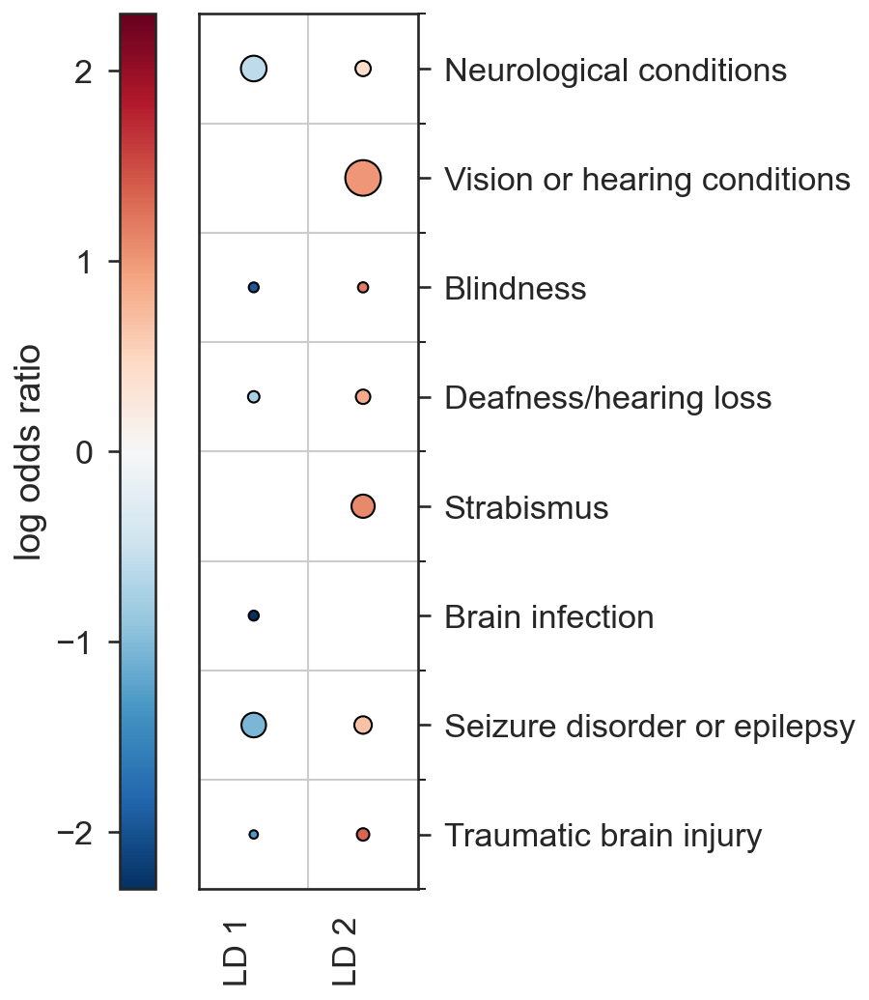

In [34]:
vmin = -2.3
vmax = 2.3
max_size = test_p.applymap(scale_log_pval).values.reshape(1,-1)[0]
max_size = np.max(max_size[~pd.isna(max_size)]) 
for cols in col_cat:
    heatmap_circle(test_s.astype(float)[cols].apply(np.log).fillna(0).iloc[:,::-1].T, test_p[cols].astype(float).iloc[:,::-1].T, cmap = 'RdBu_r', max_size=max_size ,vmin=vmin, vmax=vmax)

<Figure size 720x720 with 0 Axes>

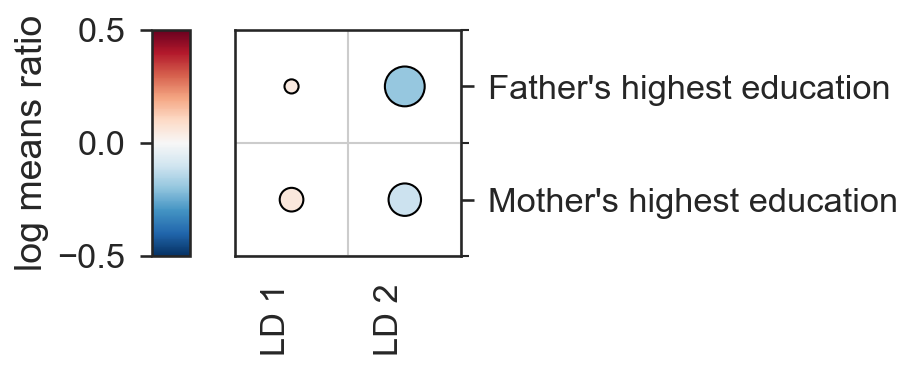

<Figure size 720x720 with 0 Axes>

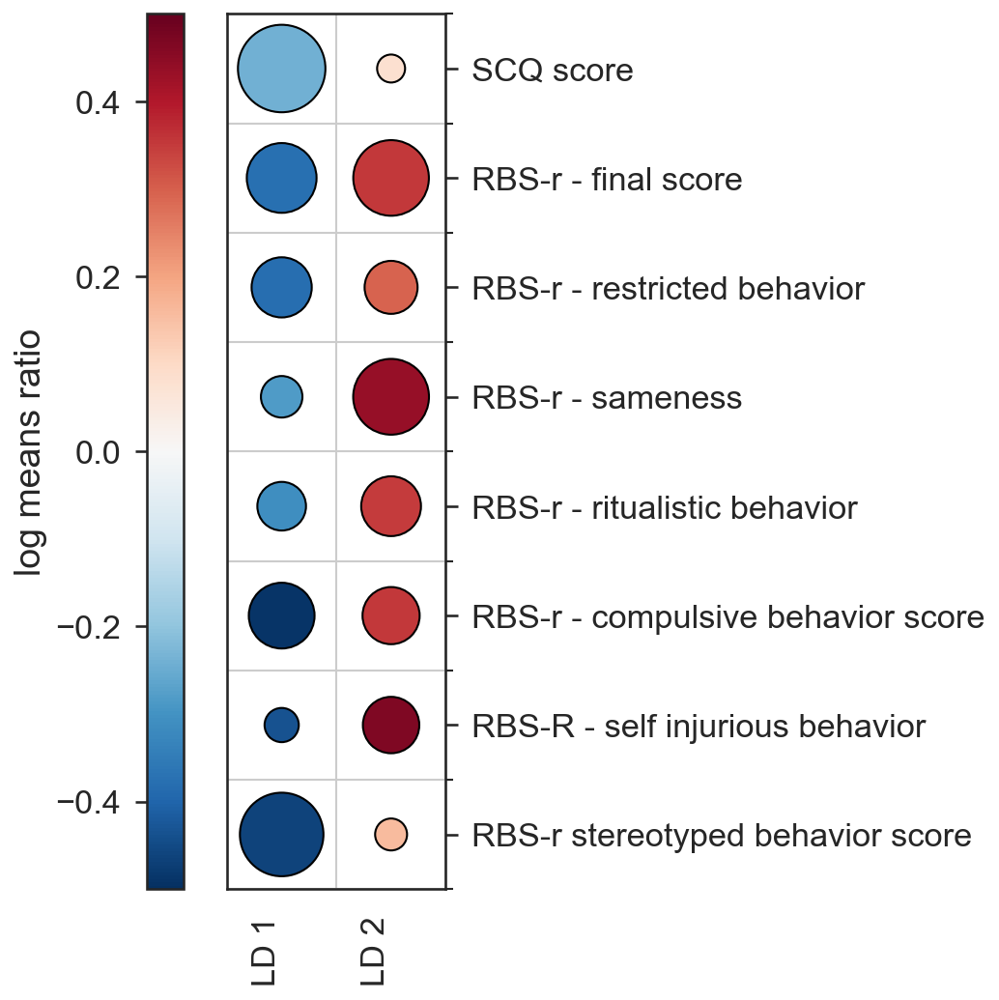

In [35]:
vmin = -0.5
vmax = 0.5
max_size = test_p.applymap(scale_log_pval).values.reshape(1,-1)[0]
max_size = np.max(max_size[~pd.isna(max_size)]) 
for cols in col_scale[:-1]:
    heatmap_circle(test_s[cols].fillna(0).applymap(np.log).T, test_p[cols].astype(float).T, cmap = 'RdBu_r', max_size=max_size, colorbar_label = 'log means ratio', vmin=vmin, vmax=vmax)

<Figure size 720x720 with 0 Axes>

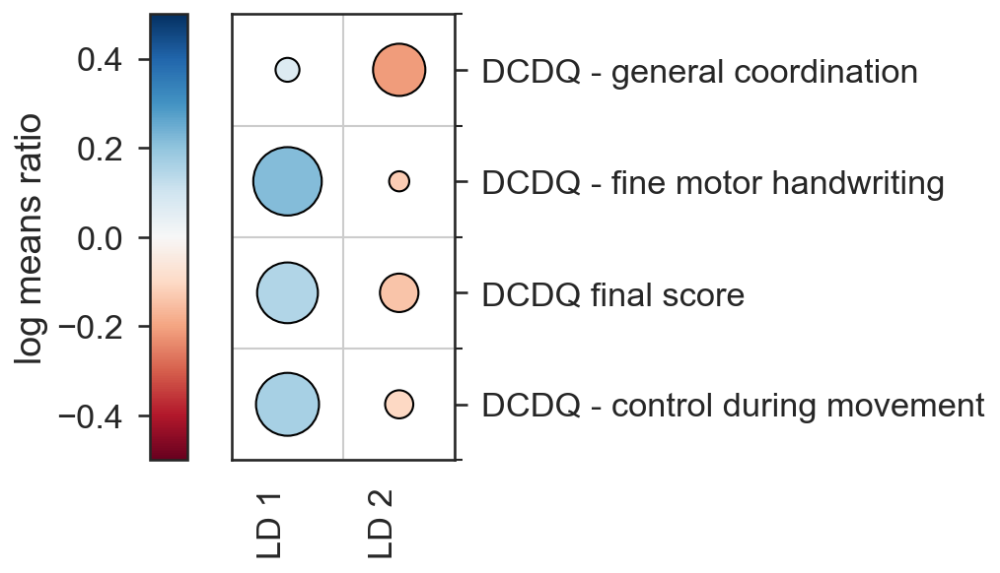

In [36]:
vmin = -0.5
vmax = 0.5
max_size = test_p.applymap(scale_log_pval).values.reshape(1,-1)[0]
max_size = np.max(max_size[~pd.isna(max_size)]) 
for cols in [col_scale[-1]]:
    heatmap_circle(test_s[cols].fillna(0).applymap(np.log).T, test_p[cols].astype(float).T, cmap = 'RdBu', max_size=max_size, colorbar_label = 'log means ratio', vmin=vmin, vmax=vmax)

In [37]:
data.to_pickle('culsteres_late.df')
ml_all_spark.loc[ml_all_spark.age_group == 1,:].to_pickle('data_y.df')

In [38]:
data_1 = data[data.clusters == 1].replace(-1,np.nan)
data_2 = data[data.clusters == 2].replace(-1,np.nan)

## Network structure ##

In [39]:
def net_struct(data, nulls = True, clusters = True):
    if clusters:
        col_pairs = [*combinations(data.drop('clusters', axis = 1).columns,2)]
        corrs = pd.DataFrame(columns=data.drop('clusters', axis = 1).columns,index = data.columns)
        p_values = pd.DataFrame(columns=data.drop('clusters', axis = 1).columns,index = data.columns)
    else:
        col_pairs = [*combinations(data.columns,2)]
        corrs = pd.DataFrame(columns=data.columns,index = data.columns)
        p_values = pd.DataFrame(columns=data.columns,index = data.columns)
    for pair in col_pairs:
        temp = pd.DataFrame({pair[1]:data[pair[1]].values, pair[0]:data[pair[0]].values}).dropna(axis = 0, how = 'any')
        s,p = pearsonr(temp[pair[1]],temp[pair[0]])
        p_values.loc[pair[0],pair[1]] = p
        corrs.loc[pair[0],pair[1]] = s   
    return corrs, p_values

wrap_text = lambda x: textwrap.fill(x, 35)

In [40]:
# corrs_1, p_values_1 =  net_struct(data_1)

In [41]:
# p_values_1_fdr, corrs_1_fdr = fdr_nan(p_values_1, corrs_1,sig= 0.0001, nulls = True, drop = False)

In [42]:
# corrs_2, p_values_2 =  net_struct(data_2)

In [43]:
# p_values_2_fdr, corrs_2_fdr = fdr_nan(p_values_2, corrs_2, sig= 0.0001, nulls = True, drop = False)

In [44]:
##### FOR DOCUMENTATION ######
#this calculation includes non signifiant results also and is ment only for the documentation#
# p_values_1_fdr, corrs_1_fdr = fdr_nan(p_values_1, corrs_1,sig= 0.0001, nulls = False, drop = False)
# p_values_2_fdr, corrs_2_fdr = fdr_nan(p_values_2, corrs_2, sig= 0.0001, nulls = False, drop = False)

# stacked_corr_2_fdr = corrs_2_fdr.stack().reset_index()
# stacked_corr_2_fdr.columns = ['Var1','Var2','correlation']
# stacked_p_values_2_fdr = p_values_2_fdr.stack().reset_index()
# stacked_p_values_2_fdr.columns = ['Var1','Var2','p_value']
# stacked_corr_p_2_fdr = stacked_corr_2_fdr.merge(stacked_p_values_2_fdr, on = ['Var1','Var2'], how = 'left')
# stacked_corr_p_2_fdr.to_csv('net_corr_p_2_fdr.csv', index = False)

# stacked_corr_1_fdr = corrs_1_fdr.stack().reset_index()
# stacked_corr_1_fdr.columns = ['Var1','Var2','correlation']
# stacked_p_values_1_fdr = p_values_1_fdr.stack().reset_index()
# stacked_p_values_1_fdr.columns = ['Var1','Var2','p_value']
# stacked_corr_p_1_fdr = stacked_corr_1_fdr.merge(stacked_p_values_1_fdr, on = ['Var1','Var2'], how = 'left')
# stacked_corr_p_1_fdr.to_csv('net_corr_p_1_fdr.csv', index = False)

In [45]:
# stacked_corr_2_fdr = corrs_2_fdr.stack().reset_index()
# stacked_corr_2_fdr.columns = ['Var1','Var2','correlation']
# stacked_corr_2_fdr['color'] = ['b' if i > 0 else 'r' for i in np.sign(stacked_corr_2_fdr.correlation)]
# stacked_corr_2_fdr = stacked_corr_2_fdr[np.abs(stacked_corr_2_fdr.correlation) > 0.1]
# stacked_corr_2_fdr['abs'] = np.abs(stacked_corr_2_fdr.correlation)

In [46]:
# corr_net2 = nx.convert_matrix.from_pandas_edgelist(stacked_corr_2_fdr, 'Var1','Var2', ['correlation','color','abs'])
# nx.readwrite.graphml.write_graphml(corr_net2, 'corr_net2.graphml')
corr_net2 = nx.readwrite.graphml.read_graphml('corr_net2.graphml')

In [47]:
cc = sorted([corr_net2.subgraph(g) for g in nx.find_cliques(corr_net2) if len(g)>4], key = len, reverse = True)
cc_nodes = Counter([*chain.from_iterable([i.nodes() for i in cc])])
print(f"LD2 formed {len(cc)} cliques with {len(cc_nodes)} nodes.")

LD2 formed 76 cliques with 74 nodes.


In [44]:
for node in cc_nodes:
    node = node.replace('/', ' or ').replace('Speech or  language or  intellectual or  learning disability or cognitive Impairment or  or other developmental delay or disability', 'speech')
    Path(f"LD2_cliques/{node}").mkdir(parents=True, exist_ok=True)

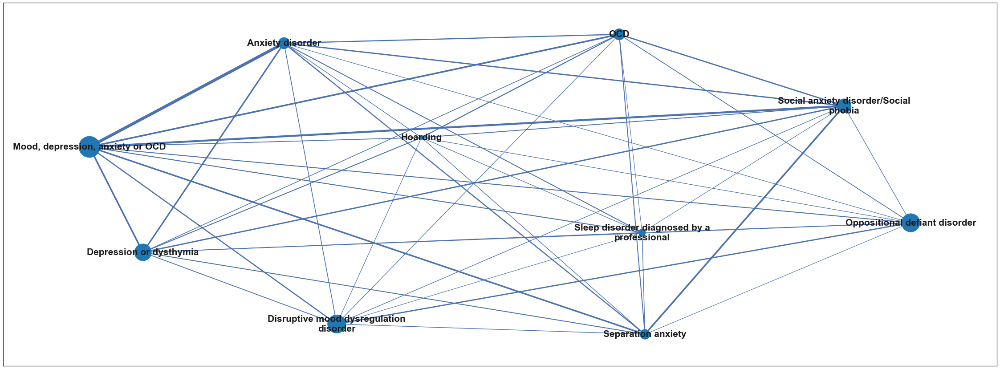

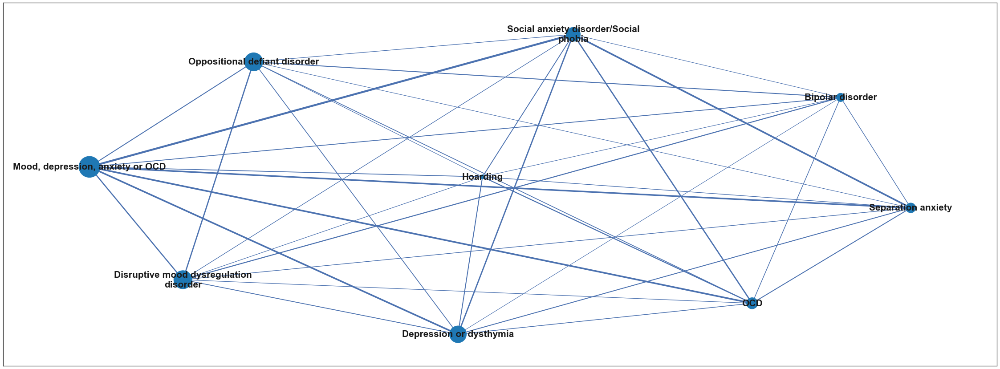

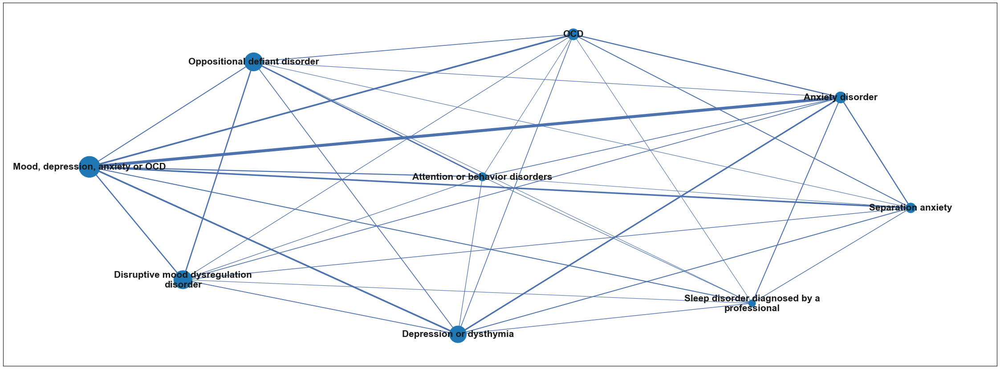

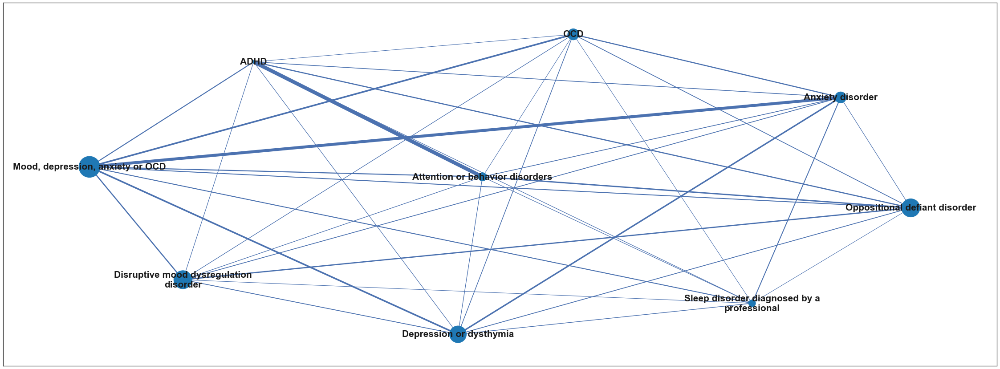

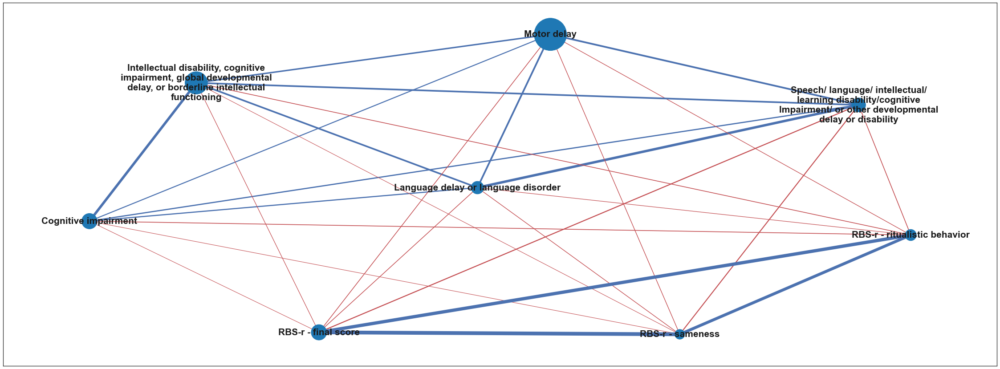

...

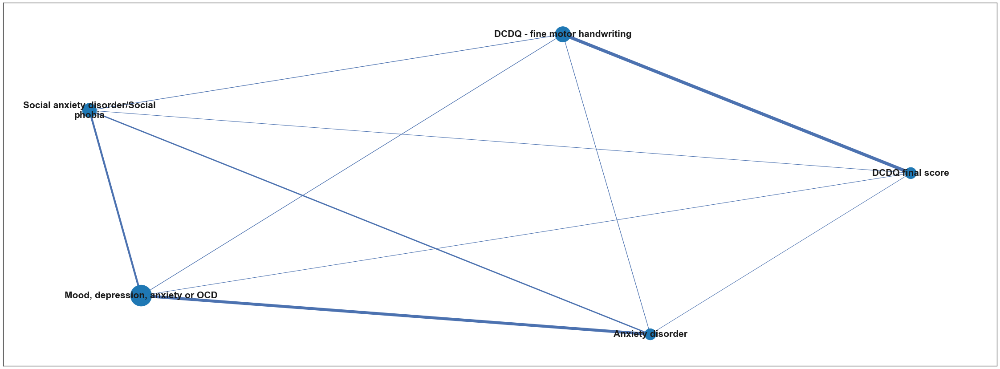

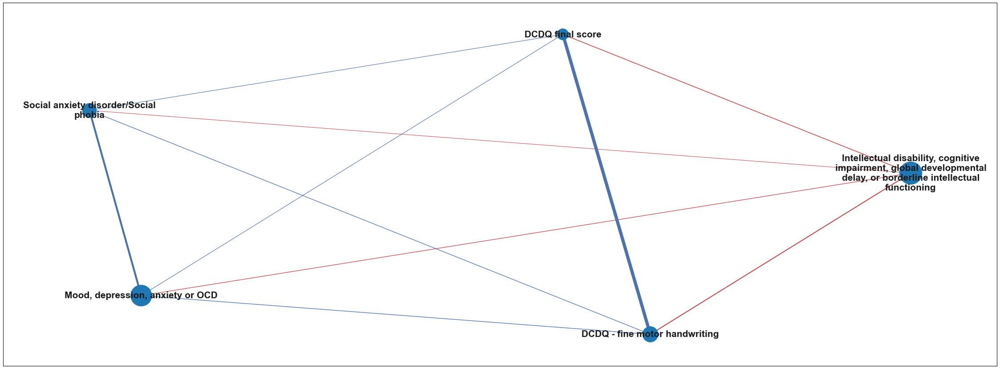

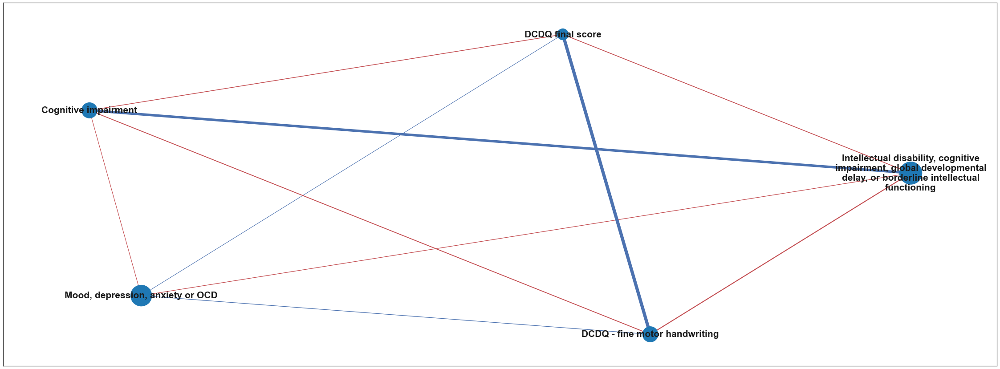

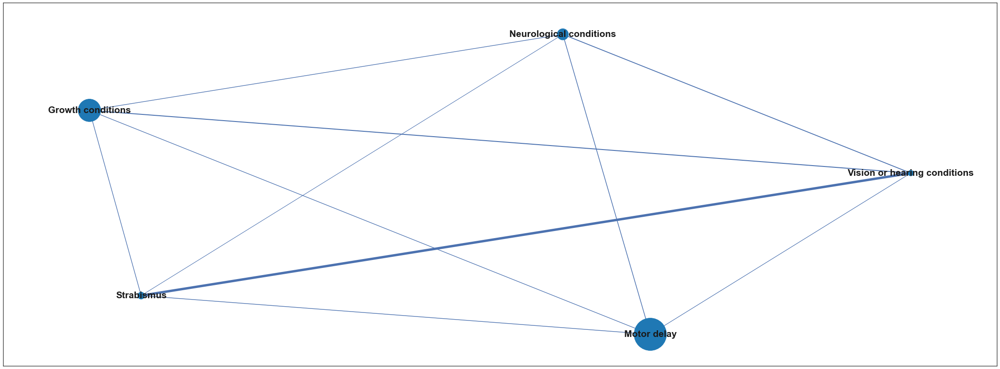

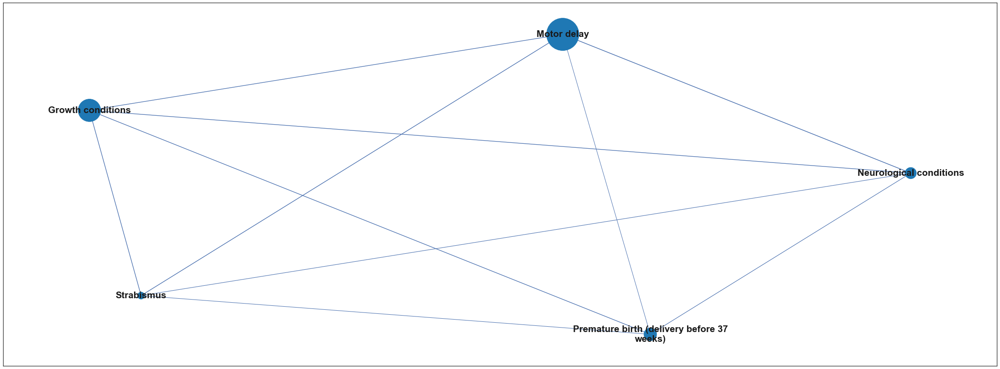

In [45]:
sns.set(font_scale = 1.5, style = 'white')
plt.ioff()
not_saved = []
for g in cc:
    edges = g.edges()
    colors = [g[u][v]['color'] for u,v in edges]
    widths = [g[u][v]['abs']*10 for u,v in edges]
    size = {k:cc_nodes[k] for k in g.nodes()}
    fig, ax = plt.subplots(figsize = (40,15))
    pos = pygraphviz_layout(g)
    nx.draw_networkx(g, pos, edge_color = colors, labels = {n:wrap_text(n) for n in g.nodes()}, width = widths,node_size=[(v**2)*10 for v in size.values()], font_weight = 'bold', font_size = 21)
    for node in g.nodes():
        node = node.replace('/', ' or ').replace('Speech or  language or  intellectual or  learning disability or cognitive Impairment or  or other developmental delay or disability', 'speech')
        try:
            plt.savefig(os.path.join('LD2_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0]) for i in g.nodes()]))), dpi = 900)
        except:
            try:
                plt.savefig(os.path.join('LD2_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0][0:2]) for i in g.nodes()]))), dpi = 900)
            except:
                not_saved.append((g,os.path.join('LD2_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0]) for i in g.nodes()])))))
                
                
plt.ion()
print(len(not_saved))

In [46]:
# stacked_corr_1_fdr = corrs_1_fdr.stack().reset_index()
# stacked_corr_1_fdr.columns = ['Var1','Var2','correlation']
# stacked_corr_1_fdr['color'] = ['b' if i > 0 else 'r' for i in np.sign(stacked_corr_1_fdr.correlation)]
# stacked_corr_1_fdr = stacked_corr_1_fdr[np.abs(stacked_corr_1_fdr.correlation) > 0.1]
# stacked_corr_1_fdr['abs'] = np.abs(stacked_corr_1_fdr.correlation)

In [48]:
# corr_net1 = nx.convert_matrix.from_pandas_edgelist(stacked_corr_1_fdr, 'Var1','Var2', ['correlation','color','abs'])
# nx.readwrite.graphml.write_graphml(corr_net1, 'corr_net1.graphml')
corr_net1 = nx.readwrite.graphml.read_graphml('corr_net1.graphml')

In [48]:
cc = sorted([corr_net1.subgraph(g) for g in nx.find_cliques(corr_net1) if len(g)>4], key = len, reverse = True)
cc_nodes = Counter([*chain.from_iterable([i.nodes() for i in cc])])
print(f"LD1 formed {len(cc)} cliques with {len(cc_nodes)} nodes.")

LD1 formed 16 cliques with 38 nodes.


In [49]:
for node in cc_nodes:
    node = node.replace('/', ' or ').replace('Speech or  language or  intellectual or  learning disability or cognitive Impairment or  or other developmental delay or disability', 'speech')
    Path(f"LD1_cliques/{node}").mkdir(parents=True, exist_ok=True)

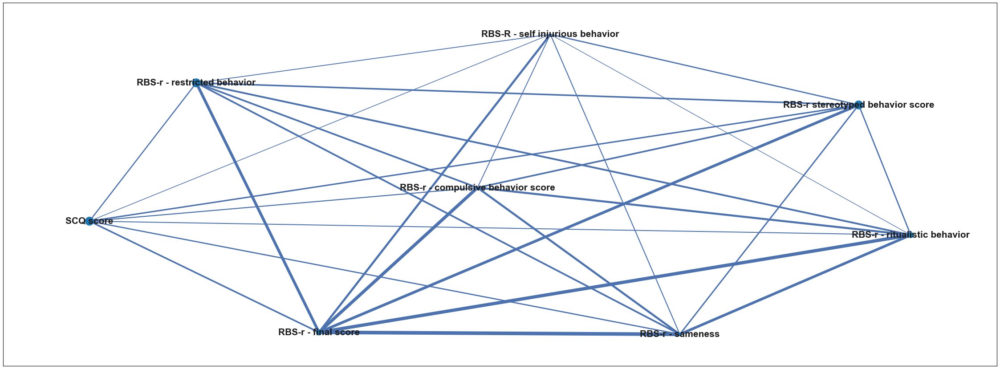

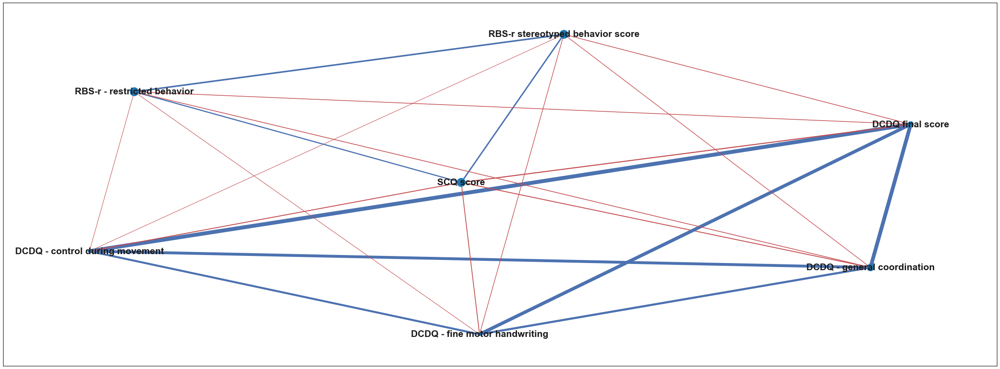

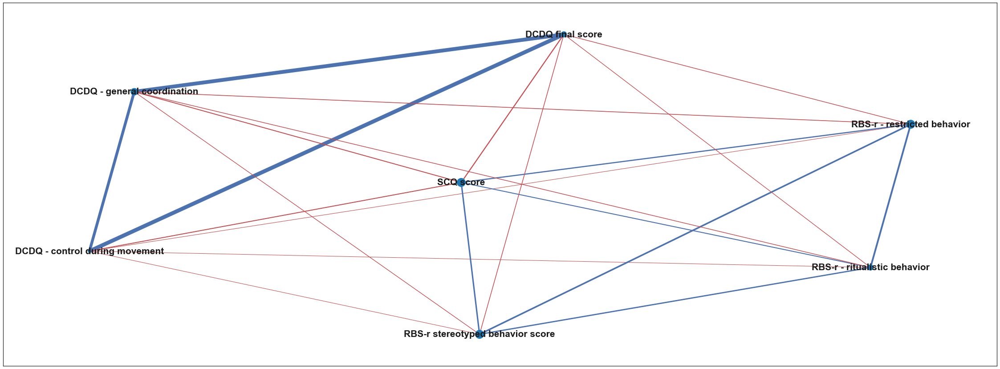

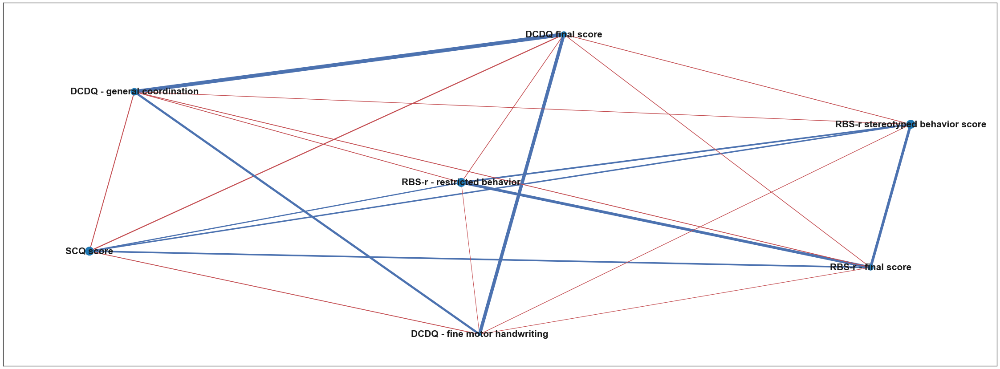

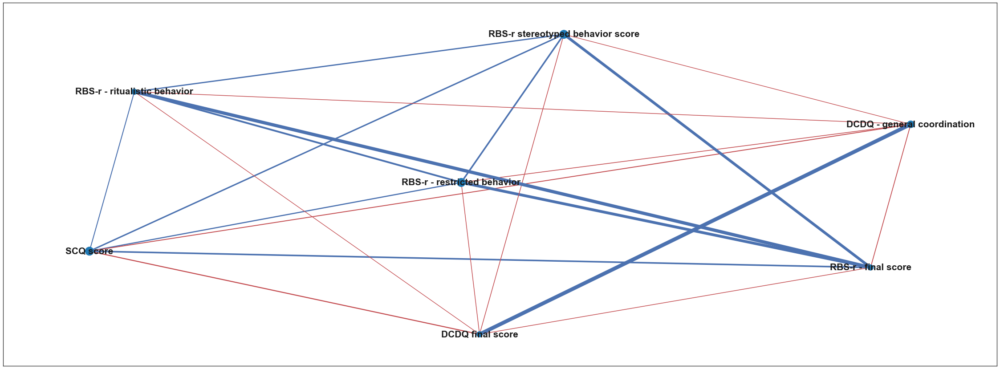

...

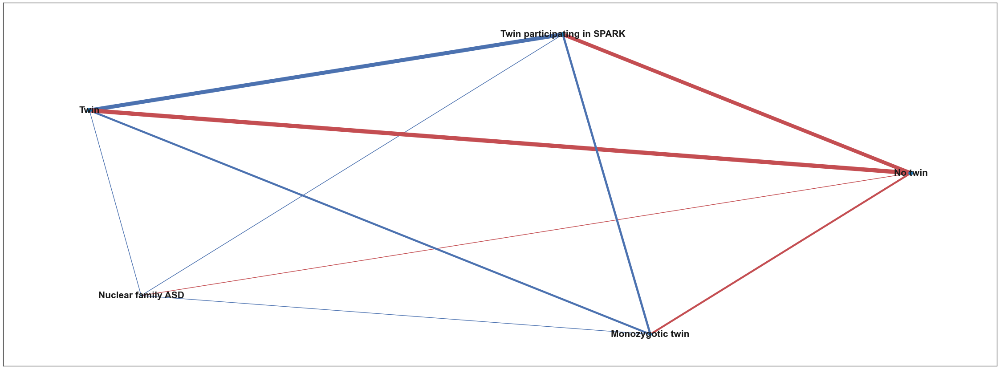

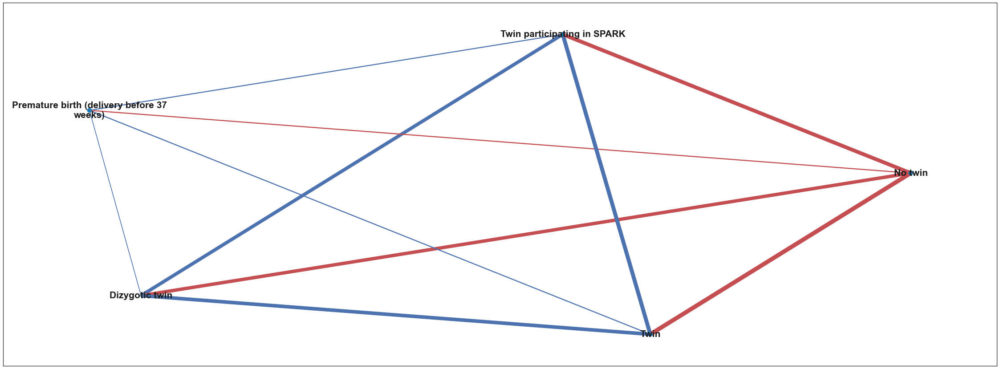

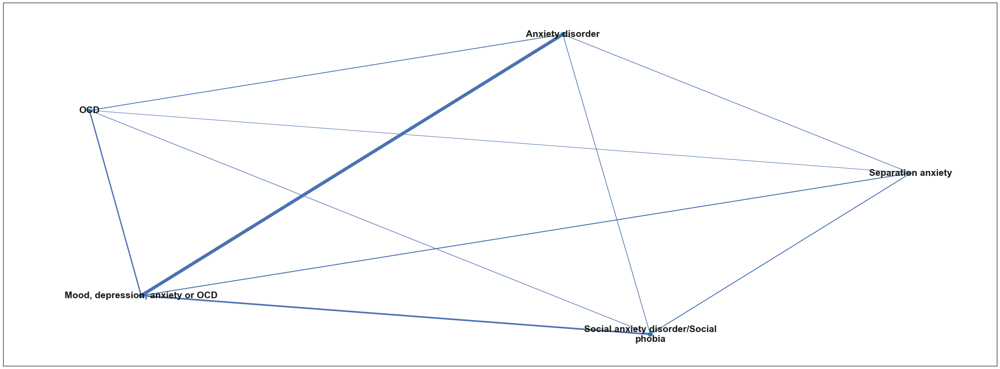

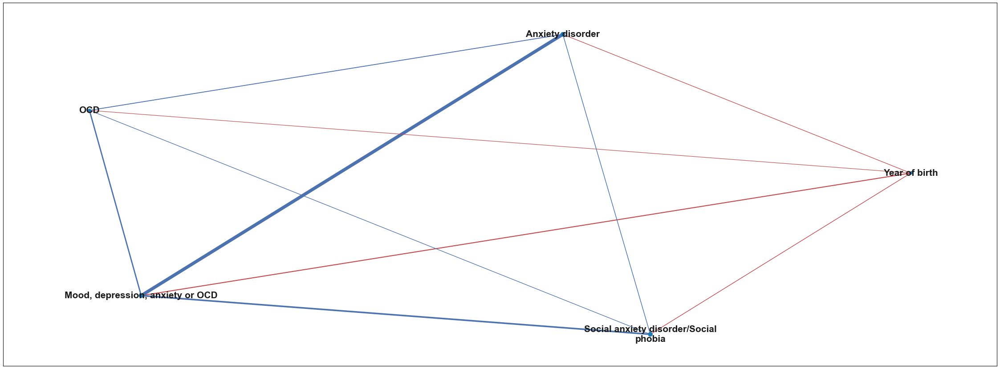

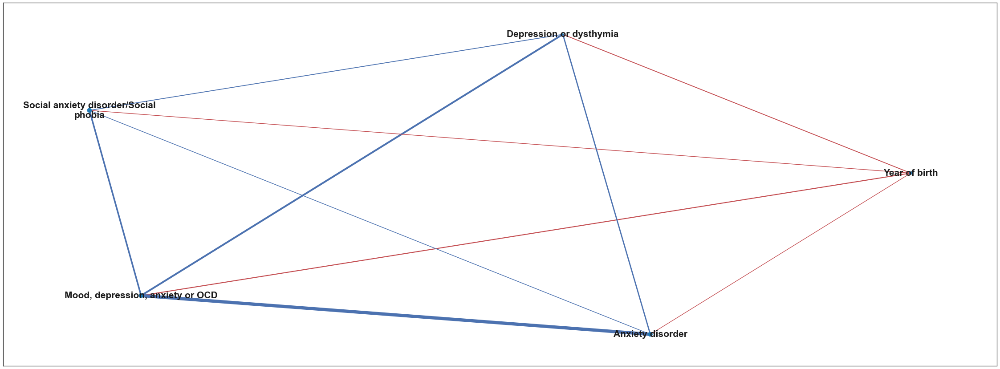

In [58]:
plt.ioff()
not_saved = []
for g in cc:
    edges = g.edges()
    colors = [g[u][v]['color'] for u,v in edges]
    widths = [g[u][v]['abs']*10 for u,v in edges]
    size = {k:cc_nodes[k] for k in g.nodes()}
    fig, ax = plt.subplots(figsize = (40,15))
    pos = pygraphviz_layout(g)
    nx.draw_networkx(g, pos, edge_color = colors, labels = {n:wrap_text(n) for n in g.nodes()}, width = widths,node_size=[(v**2)*10 for v in size.values()], font_weight = 'bold', font_size = 21)
    for node in g.nodes():
        node = node.replace('/', ' or ').replace('Speech or  language or  intellectual or  learning disability or cognitive Impairment or  or other developmental delay or disability', 'speech')
        try:
            plt.savefig(os.path.join('LD1_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0]) for i in g.nodes()]))), dpi = 900)
        except:
            try:
                plt.savefig(os.path.join('LD1_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0][0:2]) for i in g.nodes()]))), dpi = 900)
            except:
                not_saved.append((g,os.path.join('LD1_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0]) for i in g.nodes()])))))
                
                
plt.ion()

In [60]:
print(len(not_saved))
not_saved

0


[]

In [52]:
# data_ed = ml_all_spark.loc[ml_all_spark.age_group == 0,:].replace(-1,np.nan).rename(columns = names_dict)

In [53]:
corrs_ed, p_values_ed =  net_struct(data_ed, clusters=False)

In [56]:
##### FOR DOCUMENTATION ######
#this calculation includes non signifiant results also and is ment only for the documentation#
# p_values_ed_fdr, corrs_ed_fdr = fdr_nan(p_values_ed, corrs_ed,sig= 0.0001, nulls = False, drop = False)
# stacked_corr_ed_fdr = corrs_ed_fdr.stack().reset_index()
# stacked_corr_ed_fdr.columns = ['Var1','Var2','correlation']
# stacked_p_values_ed_fdr = p_values_ed_fdr.stack().reset_index()
# stacked_p_values_ed_fdr.columns = ['Var1','Var2','p_value']
# stacked_corr_p_ed_fdr = stacked_corr_ed_fdr.merge(stacked_p_values_ed_fdr, on = ['Var1','Var2'], how = 'left')
# stacked_corr_p_ed_fdr.to_csv('net_corr_p_ed_fdr.csv', index = False)

In [68]:
# p_values_ed_fdr, corrs_ed_fdr = fdr_nan(p_values_ed, corrs_ed,sig= 0.0001, nulls = True, drop = False)

In [69]:
# stacked_corr_ed_fdr = corrs_ed_fdr.stack().reset_index()
# stacked_corr_ed_fdr.columns = ['Var1','Var2','correlation']
# stacked_corr_ed_fdr['color'] = ['b' if i > 0 else 'r' for i in np.sign(stacked_corr_ed_fdr.correlation)]
# stacked_corr_2_fdr = stacked_corr_2_fdr[np.abs(stacked_corr_2_fdr.correlation) > 0.1]
# stacked_corr_ed_fdr['abs'] = np.abs(stacked_corr_ed_fdr.correlation)

In [49]:
# corr_net_ed = nx.convert_matrix.from_pandas_edgelist(stacked_corr_ed_fdr, 'Var1','Var2', ['correlation','color','abs'])
# nx.readwrite.graphml.write_graphml(corr_net_ed, 'corr_net_ed.graphml')
corr_net_ed = nx.readwrite.graphml.read_graphml('corr_net_ed.graphml')

In [71]:
cc = sorted([corr_net_ed.subgraph(g) for g in nx.find_cliques(corr_net_ed) if 8>=len(g)>4], key = len, reverse = True)
cc_nodes = Counter([*chain.from_iterable([i.nodes() for i in cc])])
print(f"EDG formed {len(cc)} cliques with {len(cc_nodes)} nodes.")

EDG formed 82 cliques with 90 nodes.


In [72]:
for node in cc_nodes:
    node = node.replace('/', ' or ')
    Path(f"ED_cliques/{node}").mkdir(parents=True, exist_ok=True)

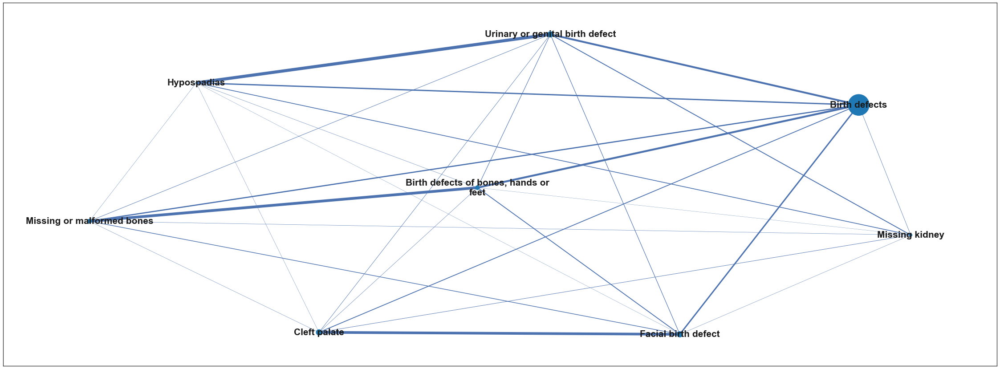

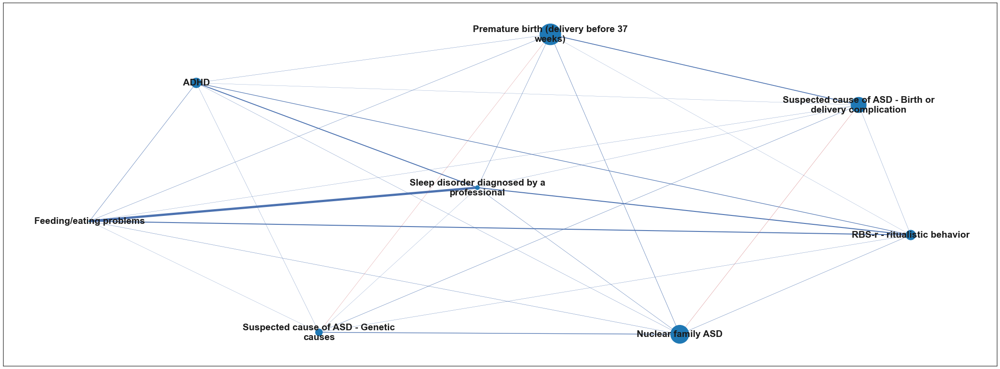

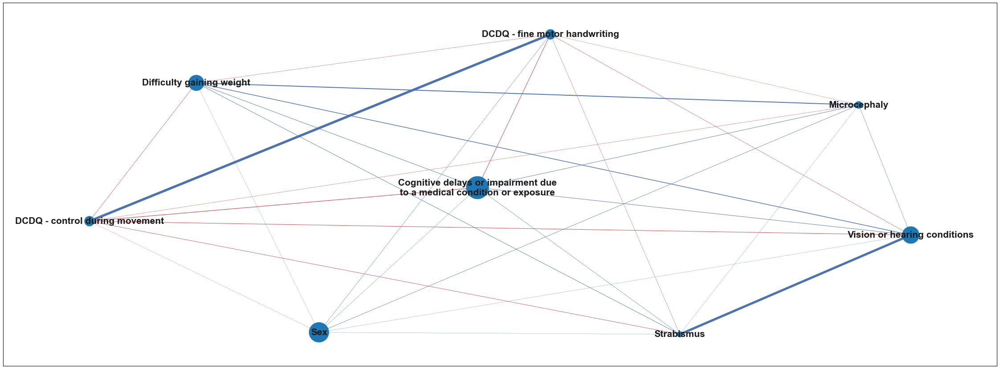

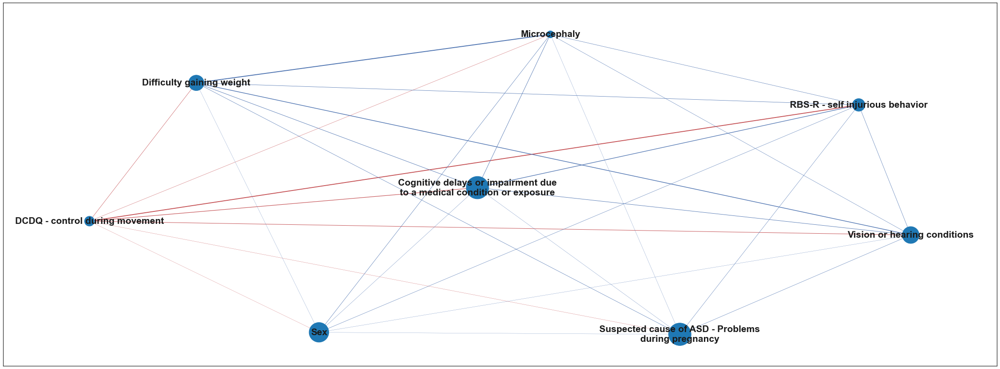

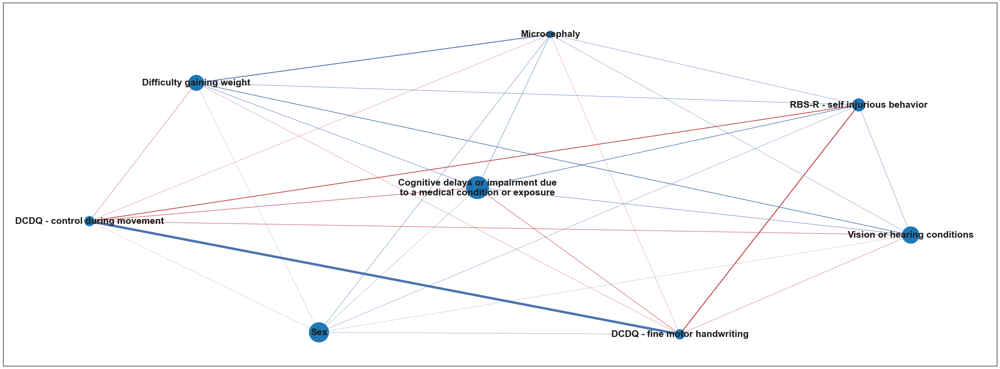

...

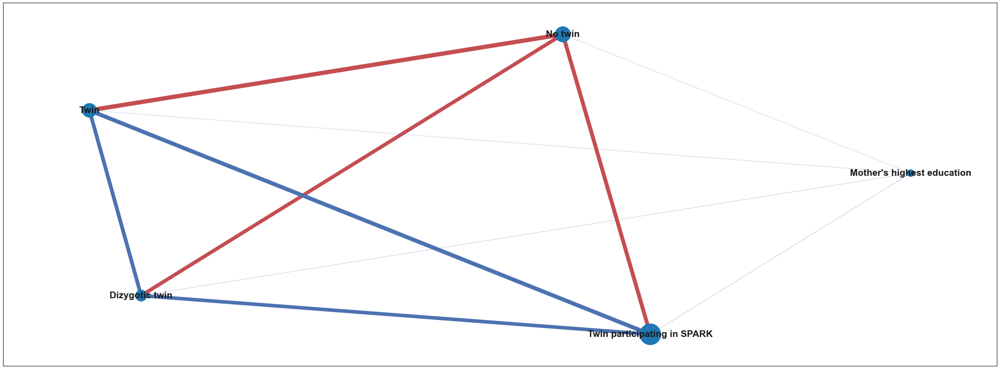

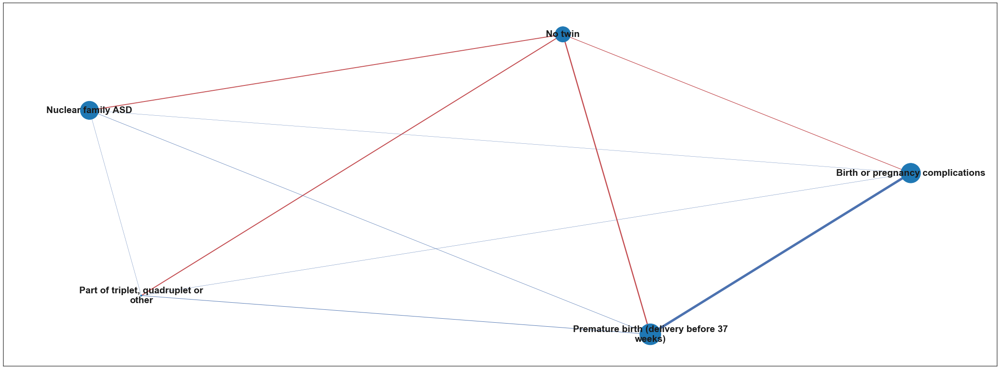

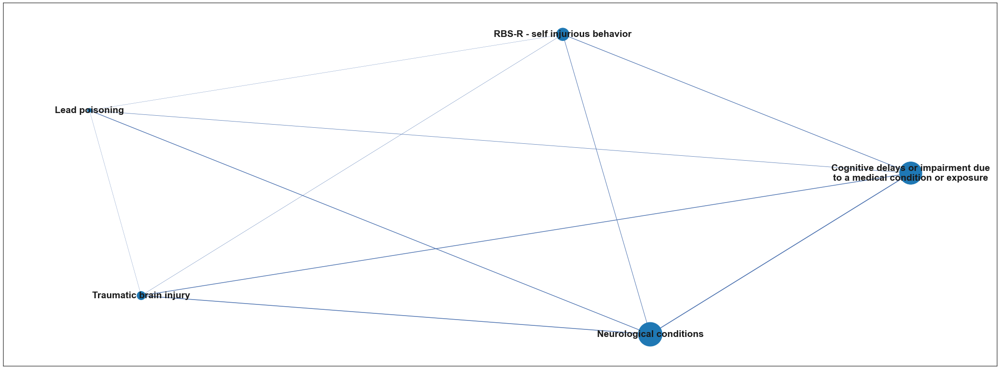

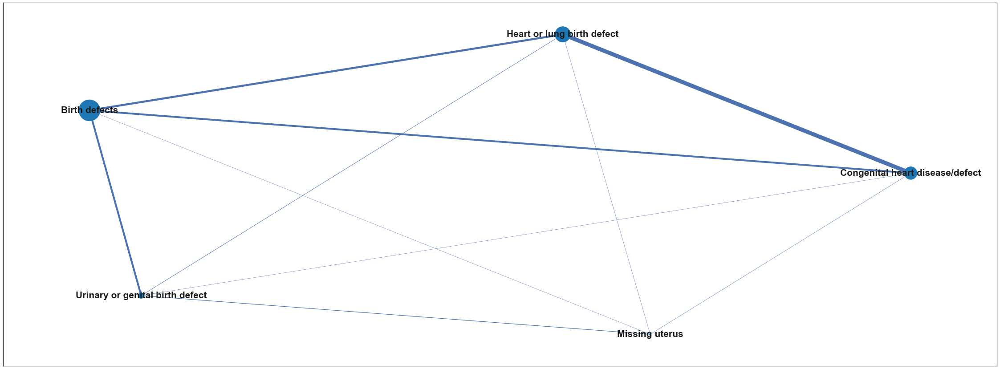

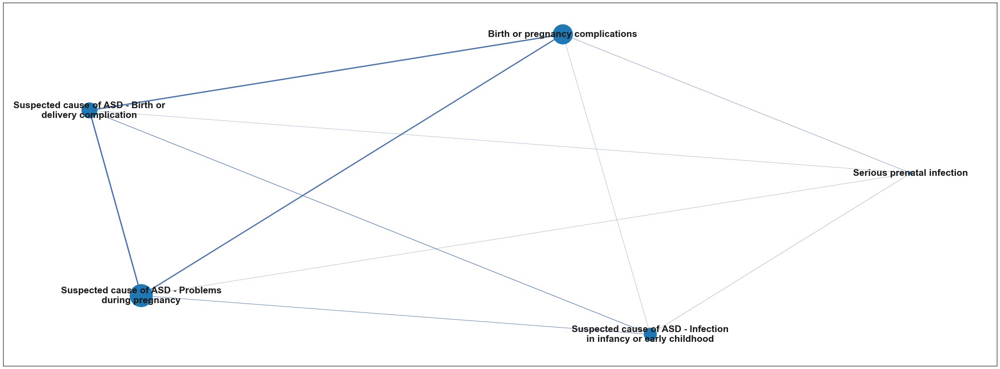

In [73]:
plt.ioff()
for g in cc:
    edges = g.edges()
    colors = [g[u][v]['color'] for u,v in edges]
    widths = [g[u][v]['abs']*10 for u,v in edges]
    size = {k:cc_nodes[k] for k in g.nodes()}
    fig, ax = plt.subplots(figsize = (40,15))
    pos = pygraphviz_layout(g)
    nx.draw_networkx(g, pos, edge_color = colors, labels = {n:wrap_text(n) for n in g.nodes()}, width = widths,node_size=[(v**2)*10 for v in size.values()], font_weight = 'bold', font_size = 21)
    for node in g.nodes():
        node = node.replace('/', ' or ').replace('Speech or  language or  intellectual or  learning disability or cognitive Impairment or  or other developmental delay or disability', 'speech')
        try:
            plt.savefig(os.path.join('ED_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0]) for i in g.nodes()]))), dpi = 900)
        except:
            plt.savefig(os.path.join('ED_cliques',node, "{}.jpeg".format('_'.join([re.sub(r'[\\/*?:"<>|\-\ ]',"_",i.split(' ')[0][0:2]) for i in g.nodes()]))))       
plt.ion()

In [50]:
dirs = ['ED_cliques','LD1_cliques','LD2_cliques']
all_nodes = set(os.listdir(dirs[0])).union(set(os.listdir(dirs[1]))).union(set(os.listdir(dirs[2])))
clique_summary = pd.DataFrame(index = all_nodes, columns = dirs).sort_index()
for node in all_nodes:
    for d in dirs:
        if node in os.listdir(d):
            clique_summary.loc[node,d] = len(os.listdir(os.path.join(d,node)))
        else:
            clique_summary.loc[node,d] = 0
clique_summary = clique_summary.apply(lambda x: (x/x.sum())*100)            
# clique_summary.to_excel('clique_summary.xls')    

FileNotFoundError: [WinError 3] The system cannot find the path specified: 'ED_cliques'